In [1]:
import os
os.environ["KMP_DUPLICATE_LIB_OK"] = "TRUE"

<h1 style="font-size:4em;">
سوال 1 
LOGISTIC REGRESSION
</h1>

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score
from sklearn.metrics import (
    accuracy_score, precision_score, recall_score,
    f1_score, roc_auc_score, confusion_matrix,
    classification_report
)
from sklearn.linear_model import LogisticRegression

In [3]:
train_df = pd.read_csv('train_data.csv')
test_df  = pd.read_csv('test_data.csv')
TARGET_COL = 'status'
X_train = train_df.drop(columns=TARGET_COL)
y_train = train_df[TARGET_COL]
X_test  = test_df.drop(columns=TARGET_COL)
y_test  = test_df[TARGET_COL]
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled  = scaler.transform(X_test)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=X_train.columns)
X_test_scaled  = pd.DataFrame(X_test_scaled,  columns=X_test.columns)

In [5]:
lr_model = LogisticRegression(solver='liblinear', random_state=42)
lr_model.fit(X_train_scaled, y_train)
y_train_pred = lr_model.predict(X_train_scaled)
print("Training Accuracy: ", accuracy_score(y_train, y_train_pred))
print("Classification Report:\n", classification_report(y_train, y_train_pred))

Training Accuracy:  0.7483365949119374
Classification Report:
               precision    recall  f1-score   support

           0       0.72      0.81      0.76      3832
           1       0.79      0.68      0.73      3833

    accuracy                           0.75      7665
   macro avg       0.75      0.75      0.75      7665
weighted avg       0.75      0.75      0.75      7665



Test Accuracy : 0.7449
Test Precision: 0.7928
Test Recall   : 0.6628
Test F1 Score : 0.7220
Test ROC AUC  : 0.8035

Classification Report:
               precision    recall  f1-score   support

           0       0.71      0.83      0.76       959
           1       0.79      0.66      0.72       958

    accuracy                           0.74      1917
   macro avg       0.75      0.74      0.74      1917
weighted avg       0.75      0.74      0.74      1917



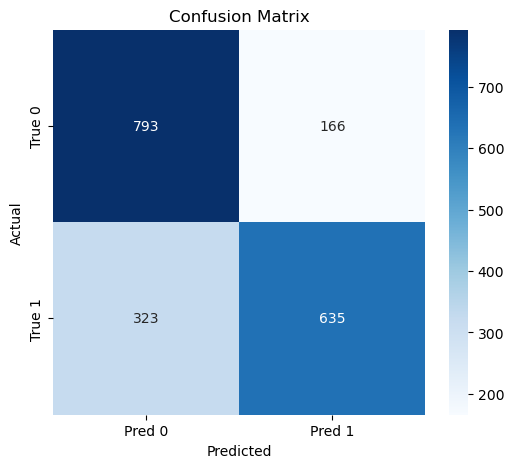

Feature Coefficients (sorted by importance):
  longest_words_raw: 10.0256
  length_hostname: 5.6420
  shortest_word_host: 5.4088
  nb_slash: 2.3298
  nb_dots: 2.1356
  shortest_words_raw: -0.3744
  avg_words_raw: -0.5394
  longest_word_host: -2.7801
  avg_word_host: -2.7891
  length_url: -4.0871


In [7]:
y_test_pred  = lr_model.predict(X_test_scaled)
y_test_proba = lr_model.predict_proba(X_test_scaled)[:, 1]
acc     = accuracy_score(y_test, y_test_pred)
prec    = precision_score(y_test, y_test_pred)
rec     = recall_score(y_test, y_test_pred)
f1      = f1_score(y_test, y_test_pred)
roc_auc = roc_auc_score(y_test, y_test_proba)
print(f"Test Accuracy : {acc:.4f}")
print(f"Test Precision: {prec:.4f}")
print(f"Test Recall   : {rec:.4f}")
print(f"Test F1 Score : {f1:.4f}")
print(f"Test ROC AUC  : {roc_auc:.4f}\n")
print("Classification Report:\n", classification_report(y_test, y_test_pred))
cm = confusion_matrix(y_test, y_test_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues',
            xticklabels=['Pred 0','Pred 1'],
            yticklabels=['True 0','True 1'])
plt.title("Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()
feature_importance = pd.Series(lr_model.coef_[0], index=X_test.columns)
feature_importance = feature_importance.sort_values(ascending=False)
print("Feature Coefficients (sorted by importance):")
for feat, coef in feature_importance.items():
    print(f"  {feat}: {coef:.4f}")

<h1 style="font-size:4em;">
SVM
</h1>

SVM Test Accuracy : 0.7986
SVM Test Precision: 0.8206
SVM Test Recall   : 0.7641
SVM Test F1 Score : 0.7914
SVM Test ROC AUC  : 0.8750

SVM Classification Report:
               precision    recall  f1-score   support

           0       0.78      0.83      0.81       959
           1       0.82      0.76      0.79       958

    accuracy                           0.80      1917
   macro avg       0.80      0.80      0.80      1917
weighted avg       0.80      0.80      0.80      1917



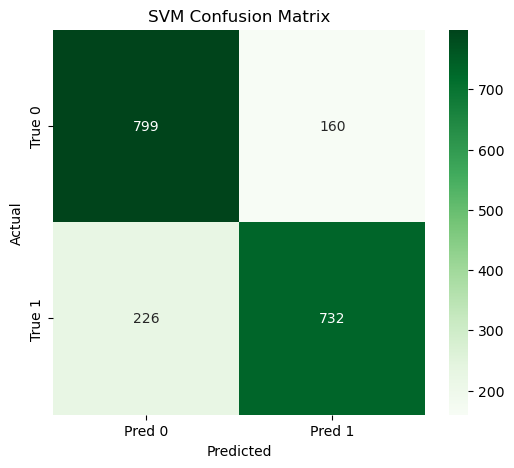

In [11]:
from sklearn.svm import SVC
svm_model = SVC(kernel='rbf', probability=True, random_state=42)
svm_model.fit(X_train_scaled, y_train)
y_svm_pred  = svm_model.predict(X_test_scaled)
y_svm_proba = svm_model.predict_proba(X_test_scaled)[:, 1]
svm_acc     = accuracy_score(y_test, y_svm_pred)
svm_prec    = precision_score(y_test, y_svm_pred)
svm_rec     = recall_score(y_test, y_svm_pred)
svm_f1      = f1_score(y_test, y_svm_pred)
svm_roc     = roc_auc_score(y_test, y_svm_proba)
print(f"SVM Test Accuracy : {svm_acc:.4f}")
print(f"SVM Test Precision: {svm_prec:.4f}")
print(f"SVM Test Recall   : {svm_rec:.4f}")
print(f"SVM Test F1 Score : {svm_f1:.4f}")
print(f"SVM Test ROC AUC  : {svm_roc:.4f}\n")
print("SVM Classification Report:\n", classification_report(y_test, y_svm_pred))
svm_cm = confusion_matrix(y_test, y_svm_pred)
plt.figure(figsize=(6, 5))
sns.heatmap(svm_cm, annot=True, fmt='d', cmap='Greens',
            xticklabels=['Pred 0','Pred 1'],
            yticklabels=['True 0','True 1'])
plt.title("SVM Confusion Matrix")
plt.ylabel("Actual")
plt.xlabel("Predicted")
plt.show()

<h1 style="font-size:4em;">
PDP(PARTIAL DEPENDENCE PLOT
</h1>

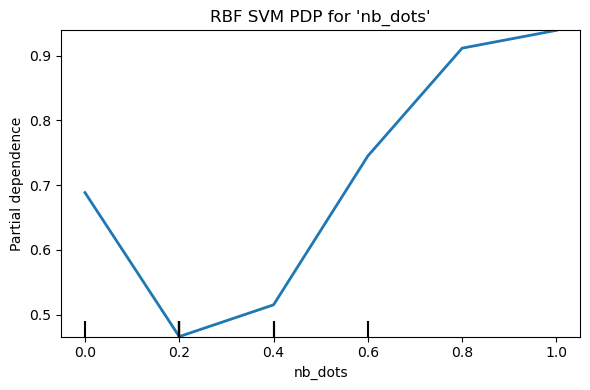

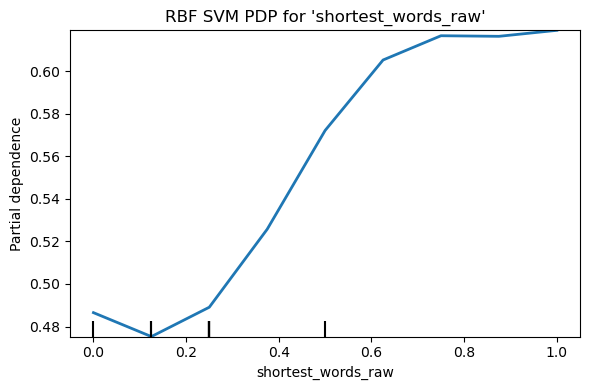

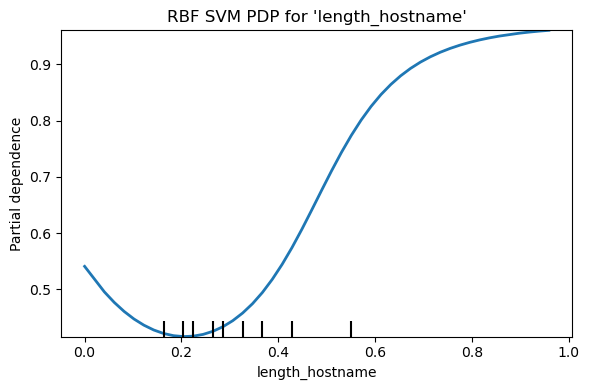

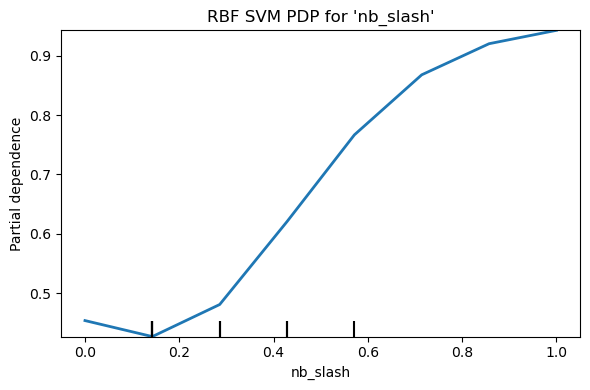

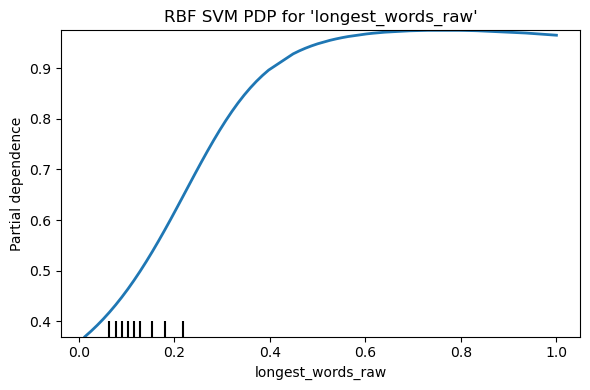

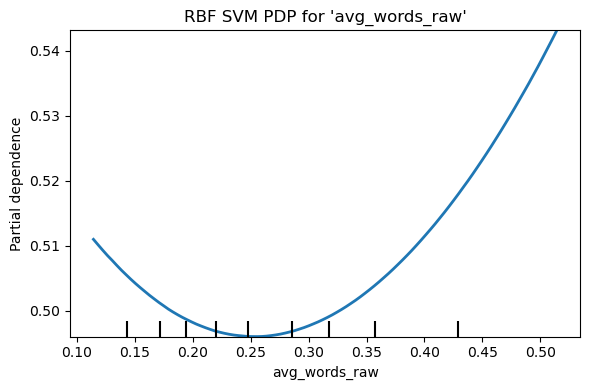

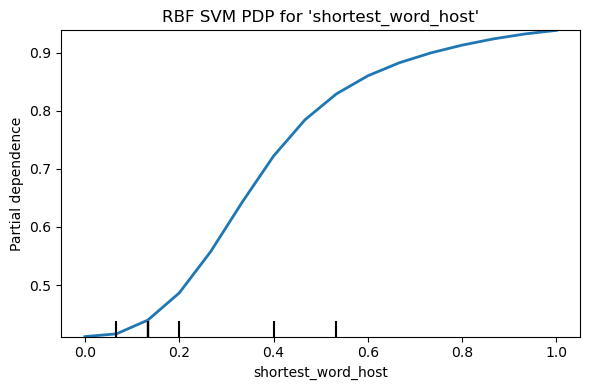

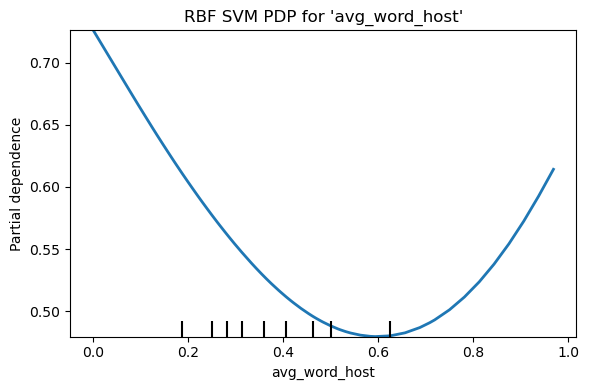

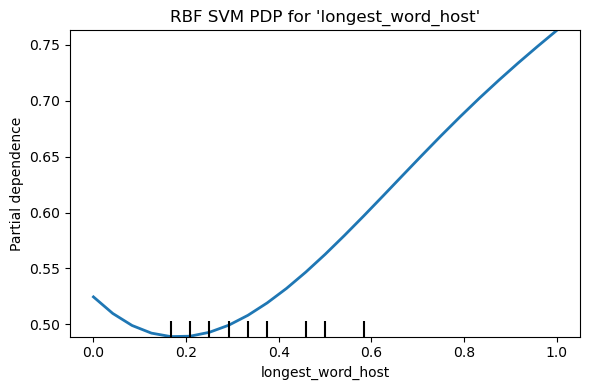

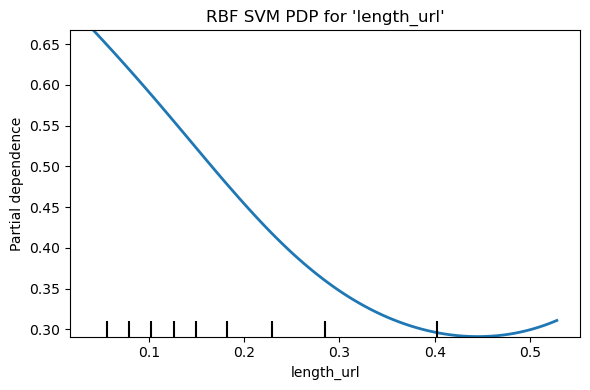

In [13]:
from sklearn.inspection import PartialDependenceDisplay
features = X_train.columns.tolist()
def plot_pdp_for_model(model, model_name, X, features):
    for feat in features:
        fig, ax = plt.subplots(figsize=(6, 4))
        PartialDependenceDisplay.from_estimator(
            model,
            X,
            [feat],
            ax=ax,
            line_kw={"linewidth": 2}
        )
        ax.set_title(f"{model_name} PDP for '{feat}'")
        plt.tight_layout()
        plt.show()
plot_pdp_for_model(svm_model, "RBF SVM", X_test_scaled, features)

<h1 style="font-size:4em;">
ICE(INDIVIDUAL CONDITIONAL EXPECTATION PLOT)
</h1>

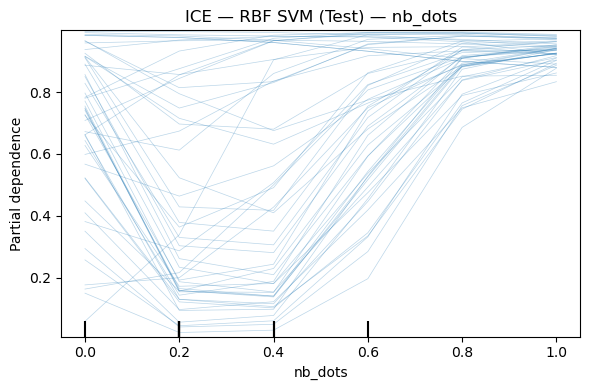

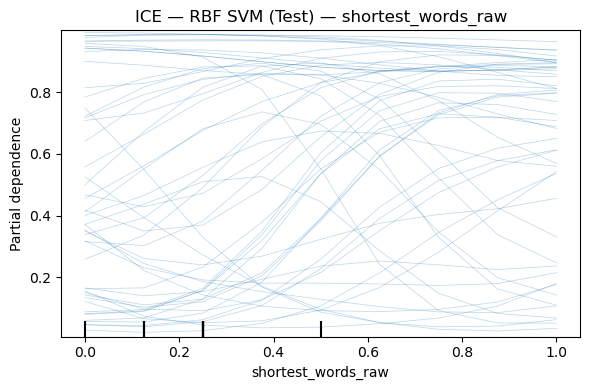

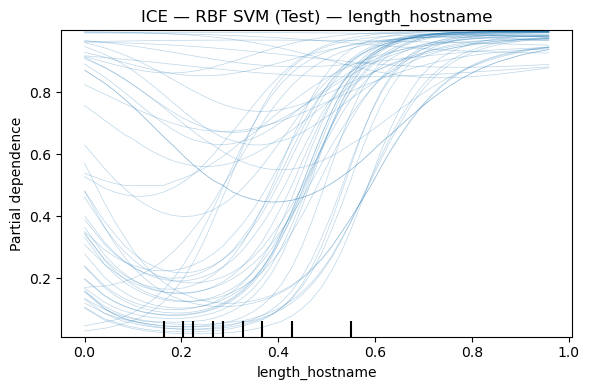

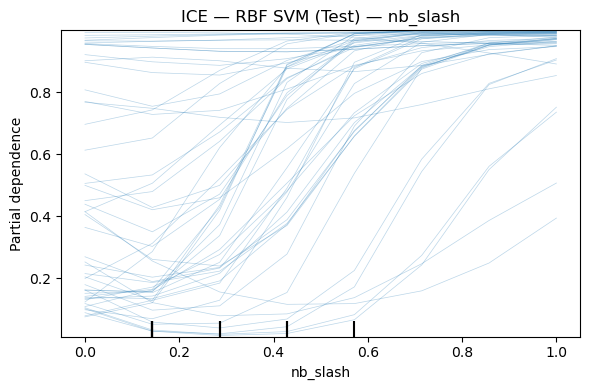

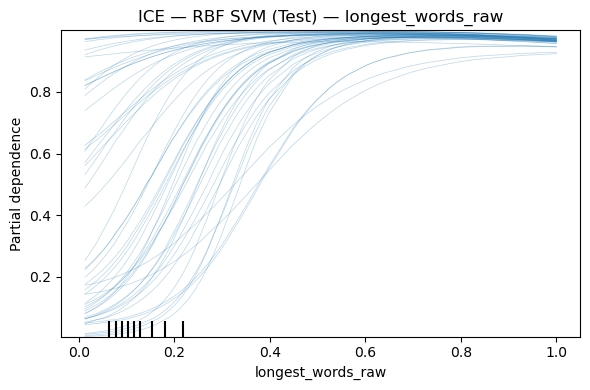

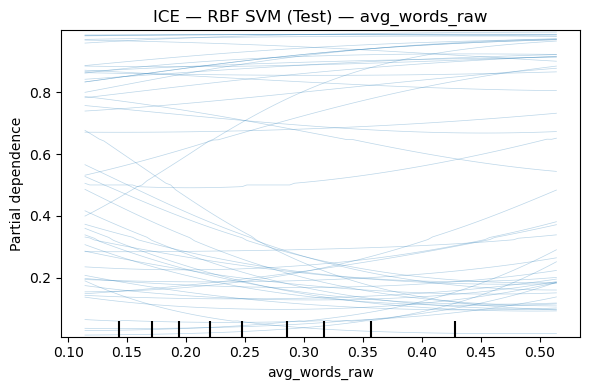

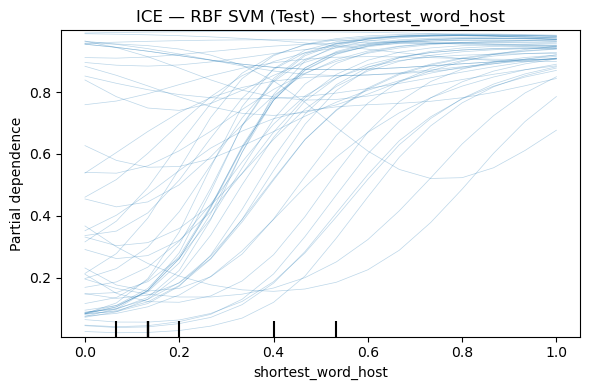

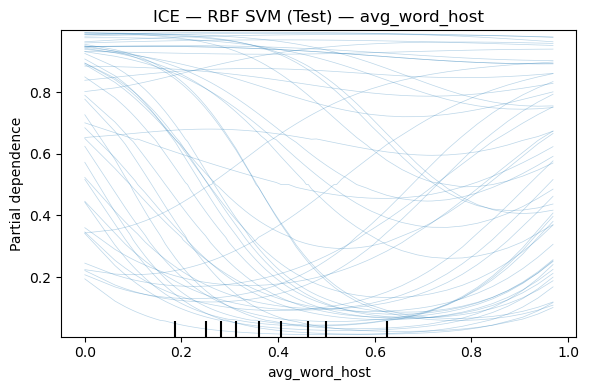

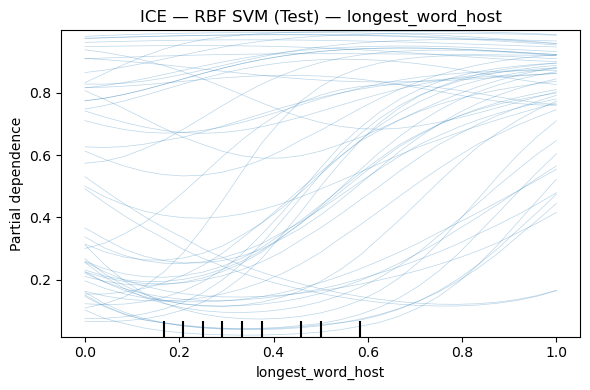

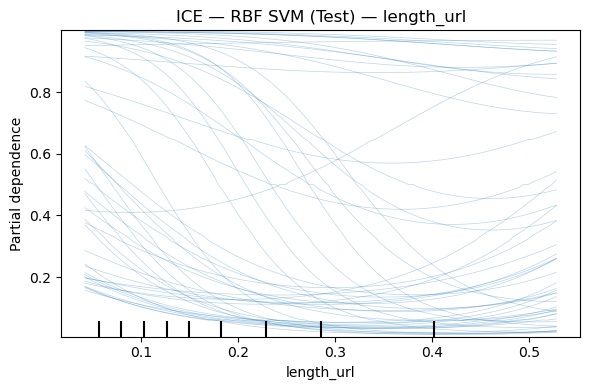

In [15]:
from sklearn.inspection import PartialDependenceDisplay
def plot_ice(model, model_name, X, features, subsample=50, random_state=42):
    for feat in features:
        fig, ax = plt.subplots(figsize=(6, 4))
        PartialDependenceDisplay.from_estimator(
            model,
            X,
            [feat],
            kind='individual',
            subsample=subsample,
            random_state=random_state,
            ax=ax
        )
        ax.set_title(f"ICE — {model_name} — {feat}")
        ax.set_xlabel(feat)
        ax.set_ylabel("Predicted Response")
        plt.tight_layout()
        plt.show()
features_test = X_test_scaled.columns.tolist()
plot_ice(
    svm_model,
    "RBF SVM (Test)",
    X_test_scaled,
    features_test,
    subsample=50,
    random_state=42
)

<h1 style="font-size:4em;">
ALE
</h1>

X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid feature names, but SVC was fitted with feature names
X does not have valid fea

array([[<Axes: xlabel='nb_dots', ylabel='ALE'>,
        <Axes: xlabel='shortest_words_raw', ylabel='ALE'>,
        <Axes: xlabel='length_hostname', ylabel='ALE'>],
       [<Axes: xlabel='nb_slash', ylabel='ALE'>,
        <Axes: xlabel='longest_words_raw', ylabel='ALE'>,
        <Axes: xlabel='avg_words_raw', ylabel='ALE'>],
       [<Axes: xlabel='shortest_word_host', ylabel='ALE'>,
        <Axes: xlabel='avg_word_host', ylabel='ALE'>,
        <Axes: xlabel='longest_word_host', ylabel='ALE'>],
       [<Axes: xlabel='length_url', ylabel='ALE'>, None, None]],
      dtype=object)

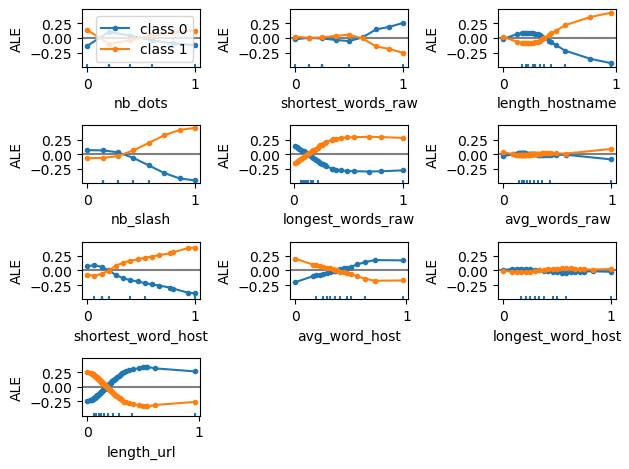

In [13]:
from alibi.explainers import ALE, plot_ale
predict_fn = lambda X: svm_model.predict_proba(X)
ale = ALE(
    predictor     = predict_fn,
    feature_names = X_test_scaled.columns.tolist(),
    target_names  = ['class 0', 'class 1']
)
ale_exp = ale.explain(X_test_scaled.values)
plot_ale(ale_exp,
         features = 'all',
         targets  = 'all',
         n_cols   = 3)

<h1 style="font-size:4em;">
LIME
</h1>

X does not have valid feature names, but SVC was fitted with feature names



--- LIME explanation for test instance #1 (index 0) ---
shortest_word_host <= 0.13: -0.1485
nb_slash <= 0.14: -0.1447
length_url <= 0.09: 0.1431
longest_words_raw <= 0.09: -0.1328
avg_word_host <= 0.25: 0.1098


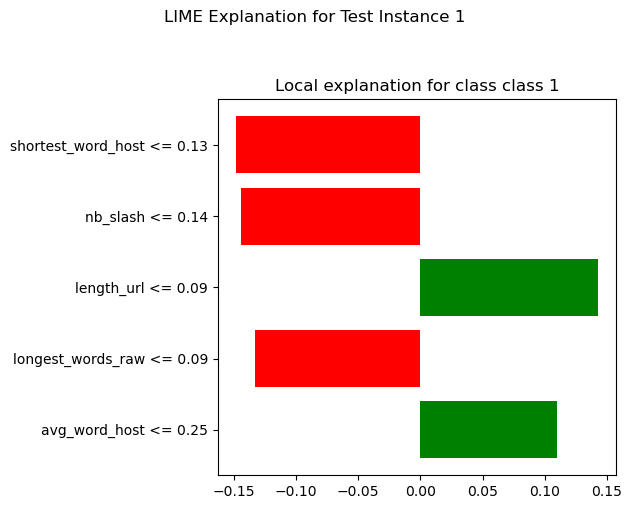

X does not have valid feature names, but SVC was fitted with feature names



--- LIME explanation for test instance #2 (index 1) ---
shortest_word_host > 0.33: 0.2098
longest_words_raw <= 0.09: -0.1128
shortest_words_raw > 0.25: 0.0832
nb_dots <= 0.20: -0.0817
0.14 < nb_slash <= 0.29: -0.0726


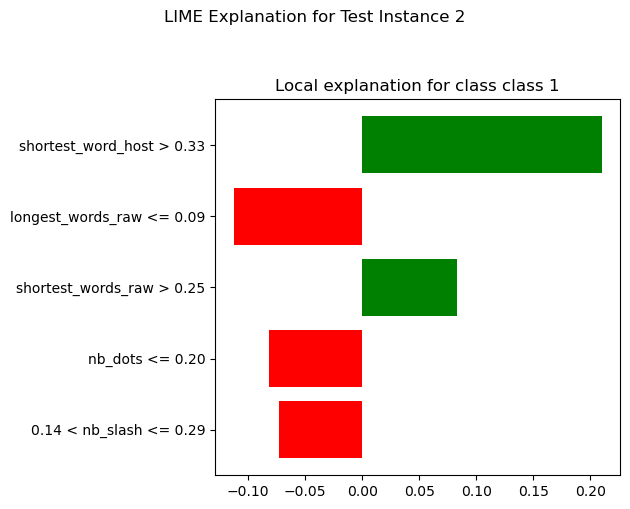

X does not have valid feature names, but SVC was fitted with feature names



--- LIME explanation for test instance #3 (index 2) ---
nb_dots > 0.40: 0.1865
shortest_word_host <= 0.13: -0.1727
0.29 < length_hostname <= 0.41: -0.0665
0.14 < nb_slash <= 0.29: -0.0602
0.15 < length_url <= 0.25: -0.0448


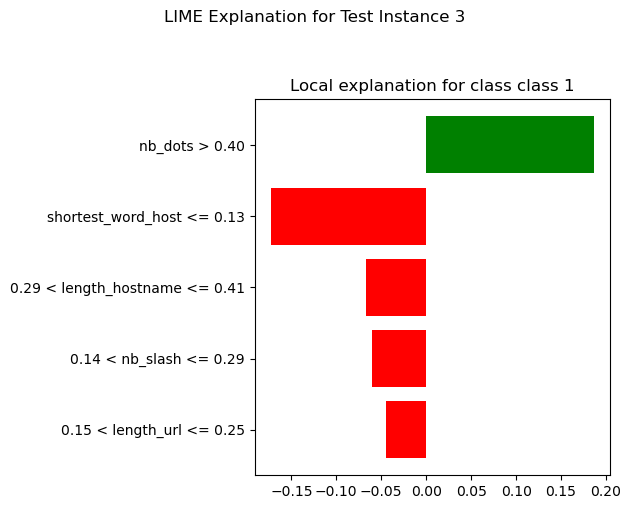

In [23]:
from lime.lime_tabular import LimeTabularExplainer
explainer = LimeTabularExplainer(
    training_data   = X_train_scaled.values,
    feature_names   = X_train_scaled.columns.tolist(),
    class_names     = ['class 0', 'class 1'],
    mode            = 'classification',
    random_state    = 42
)
instances = X_test_scaled.iloc[:3]
for idx, (i, row) in enumerate(instances.iterrows(), start=1):
    exp = explainer.explain_instance(
        data_row    = row.values,
        predict_fn  = svm_model.predict_proba,
        num_features= 5           
    )
    print(f"\n--- LIME explanation for test instance #{idx} (index {i}) ---")
   
    for feature, weight in exp.as_list():
        print(f"{feature}: {weight:.4f}")
    
    fig = exp.as_pyplot_figure()
    fig.suptitle(f"LIME Explanation for Test Instance {idx}", y=1.05)
    plt.tight_layout()
    plt.show()


<h1 style="font-size:4em;">
SHAPLEY
</h1>

Using 200 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.
100%|██████████| 3/3 [03:05<00:00, 61.98s/it]


Base SHAP value for positive class: 0.5184919560940653

Sample 1 SHAP values (sorted):
length_url            0.132676
avg_word_host         0.081795
avg_words_raw         0.019057
shortest_words_raw   -0.031630
nb_dots              -0.061312
longest_word_host    -0.086026
length_hostname      -0.091378
shortest_word_host   -0.092698
nb_slash             -0.094277
longest_words_raw    -0.146673
dtype: float64

Sample 2 SHAP values (sorted):
shortest_word_host    0.199742
shortest_words_raw    0.069386
longest_word_host     0.002484
avg_words_raw        -0.017950
avg_word_host        -0.018283
length_hostname      -0.049568
nb_slash             -0.049757
nb_dots              -0.070388
longest_words_raw    -0.090308
length_url           -0.118622
dtype: float64

Sample 3 SHAP values (sorted):
nb_dots               0.293073
longest_word_host     0.030471
avg_words_raw         0.030064
longest_words_raw    -0.002727
avg_word_host        -0.017862
length_hostname      -0.043310
nb_slash     

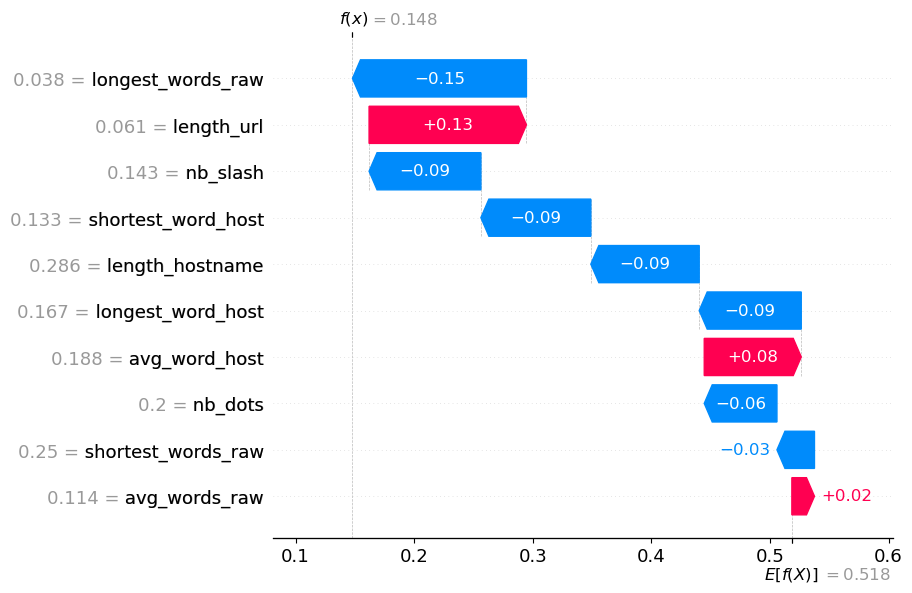

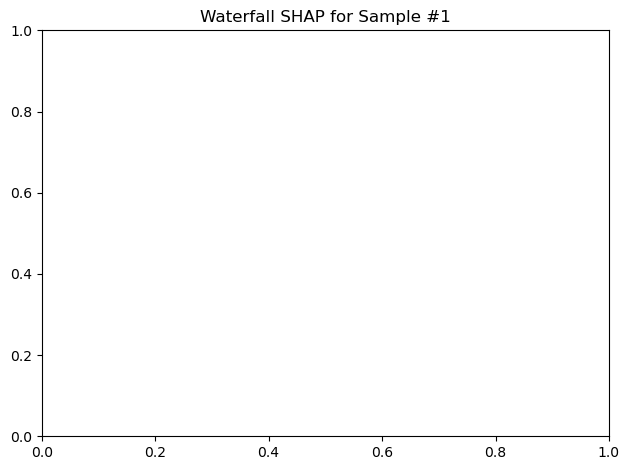

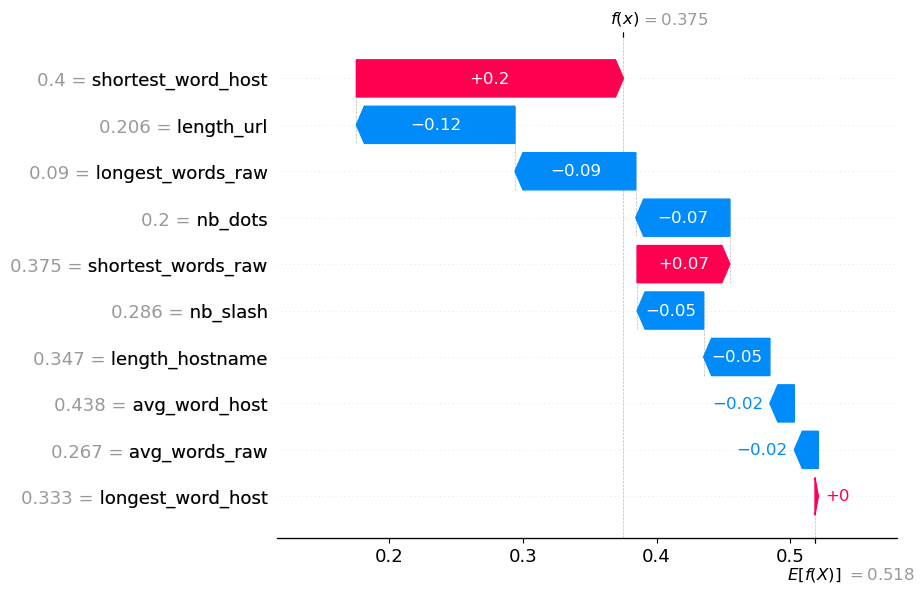

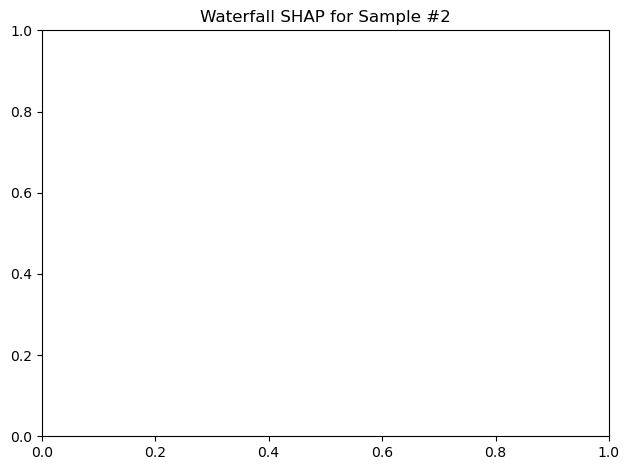

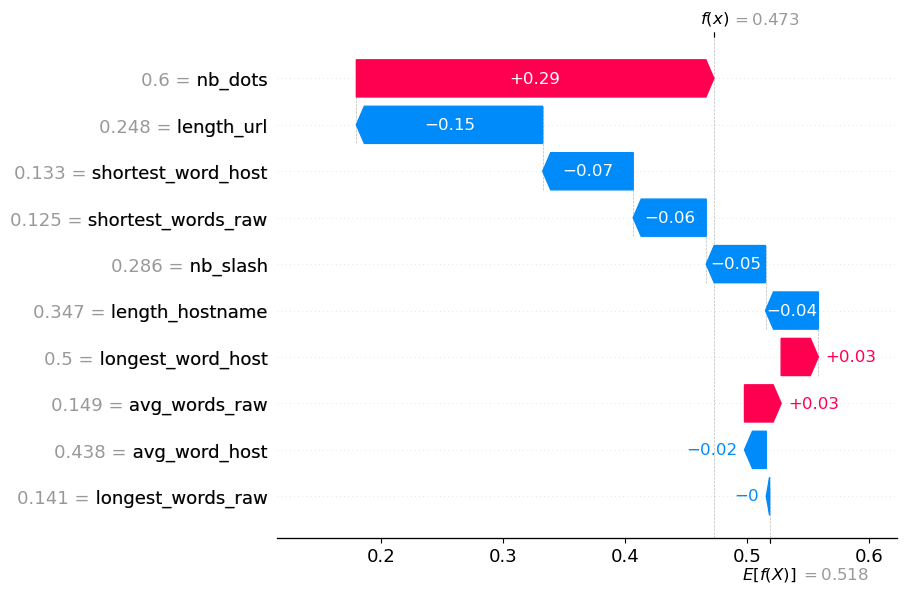

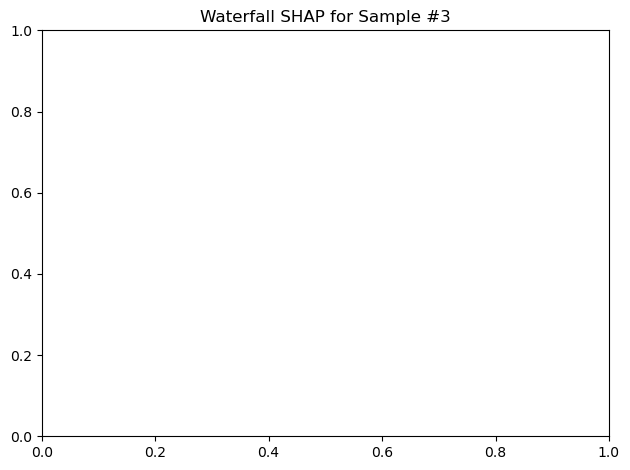

In [35]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = ""
import shap
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
background_data = X_train_scaled.sample(n=200, random_state=0)
predict_fn = lambda x: svm_model.predict_proba(pd.DataFrame(x, columns=X_train_scaled.columns))
explainer = shap.KernelExplainer(
    model=predict_fn,
    data=background_data,
    link="identity"
)
samples = X_test_scaled.iloc[:3]
shap_values = explainer.shap_values(samples)
shap_vals_pos = shap_values[1]
base_value = explainer.expected_value[1]
print("Base SHAP value for positive class:", base_value)
for i, sv in enumerate(shap_vals_pos, start=1):
    print(f"\nSample {i} SHAP values (sorted):")
    print(pd.Series(sv, index=samples.columns).sort_values(ascending=False))
for idx in range(len(samples)):
    exp = shap.Explanation(
        values       = shap_vals_pos[idx],
        base_values  = base_value,
        data         = samples.iloc[idx].values,
        feature_names= samples.columns.tolist()
    )
    plt.figure(figsize=(6, 4))
    shap.plots.waterfall(exp, show=True)
    plt.title(f"Waterfall SHAP for Sample
    plt.tight_layout()
    plt.show()

<h1 style="font-size:4em;">
NAM
</h1>

Working directory set to: C:\Users\ExoGame
Class distribution in TRAIN set:
1    0.500065
0    0.499935

Class distribution in TEST set:
0    0.500261
1    0.499739
――――――――――――――――――――――――――――――――――――――――
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Index'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Index'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Model: "nam"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
feature_nn (FeatureNN)       multiple            

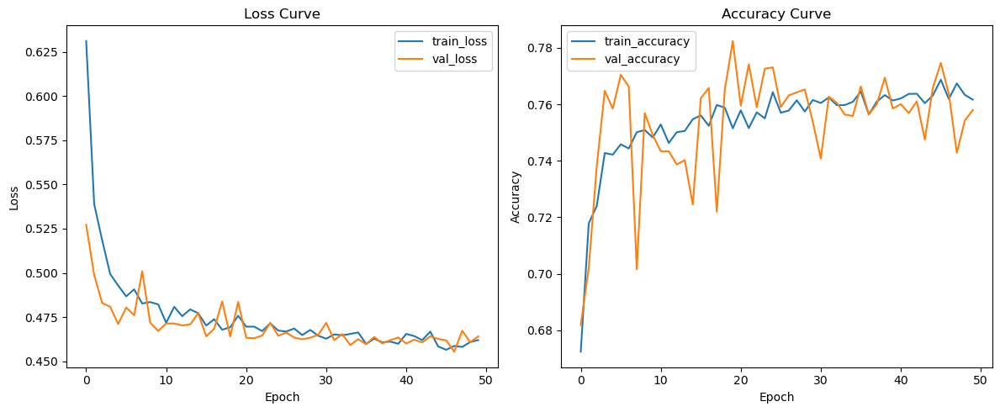

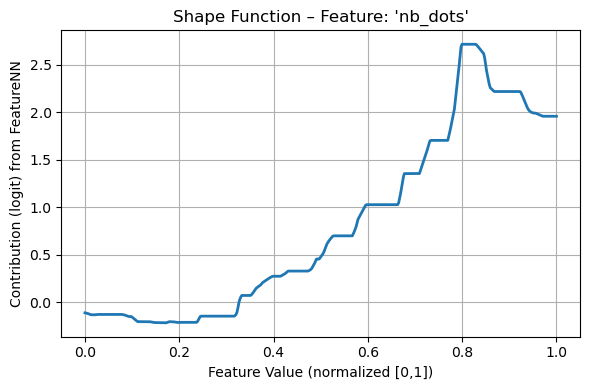

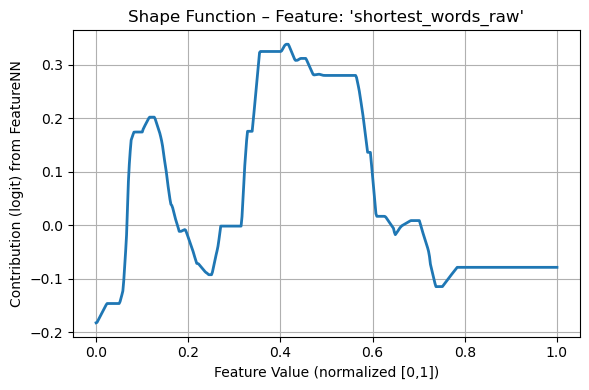

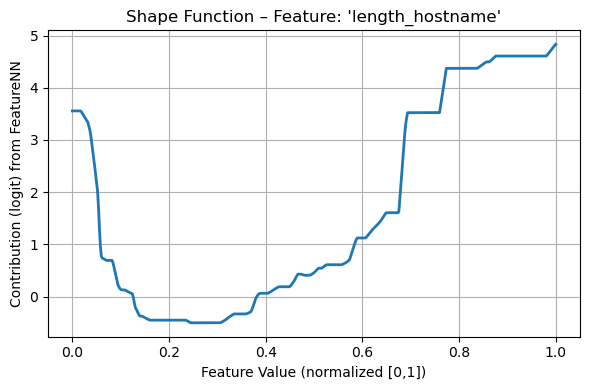

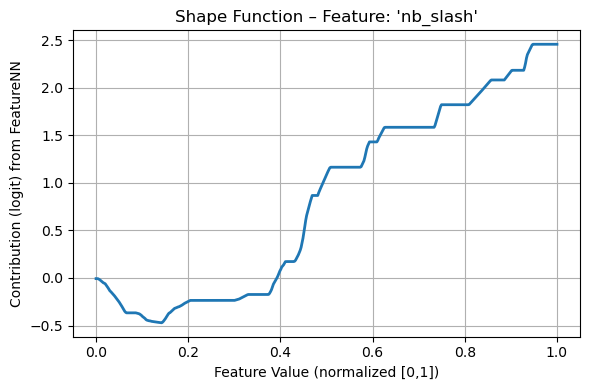

...

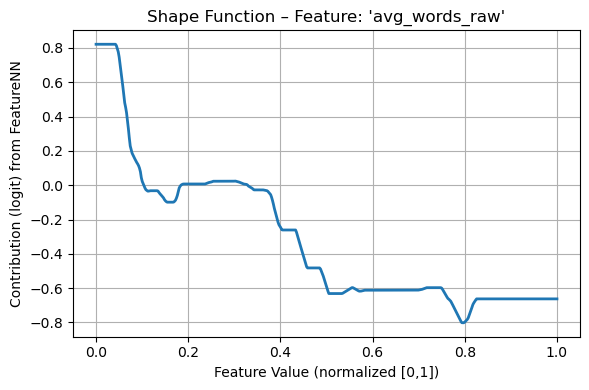

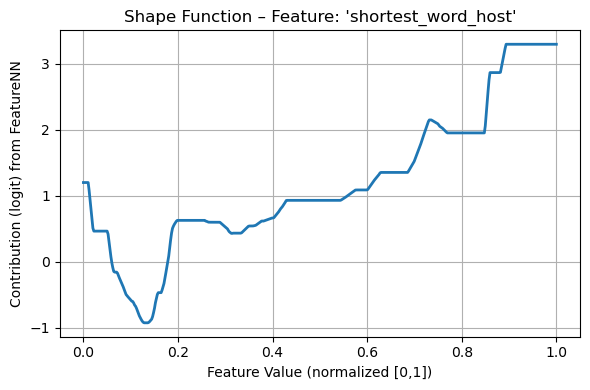

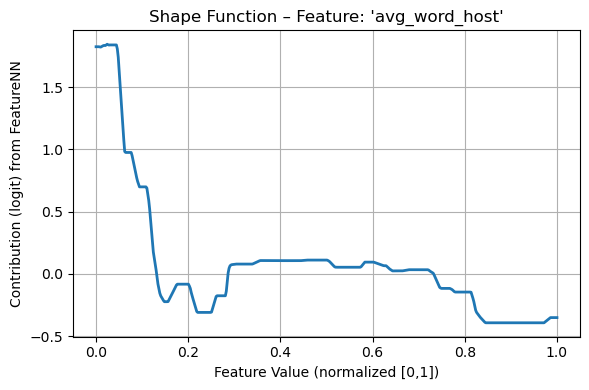

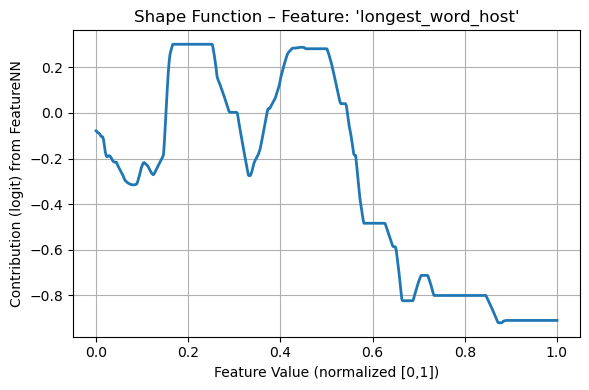

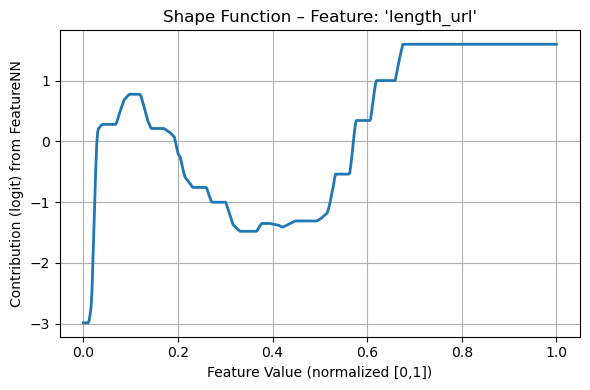

In [37]:
import os
import sys
import pandas as pd
import numpy as np
import tensorflow as tf
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
try:
    current_dir = os.path.dirname(os.path.abspath(__file__))
except NameError:
    current_dir = os.getcwd()
os.chdir(current_dir)
print(f"Working directory set to: {current_dir}")
if current_dir not in sys.path:
    sys.path.insert(0, current_dir)
from models import NAM
TRAIN_CSV       = 'train_data.csv'
TEST_CSV        = 'test_data.csv'
TARGET_COL      = 'status'
BATCH_SIZE      = 64
EPOCHS          = 50
NUM_UNITS       = 64
SHALLOW         = False
FEATURE_DROPOUT = 0.05
INNER_DROPOUT   = 0.05
L2_REGULARIZER  = 1e-3
LEARNING_RATE   = 5e-4
def load_and_preprocess_data():
    for f in [TRAIN_CSV, TEST_CSV]:
        path = os.path.join(current_dir, f)
        if not os.path.exists(path):
            raise FileNotFoundError(f"{f} not found in {current_dir}")
    train_df = pd.read_csv(os.path.join(current_dir, TRAIN_CSV))
    test_df  = pd.read_csv(os.path.join(current_dir, TEST_CSV))
    if TARGET_COL not in train_df.columns or TARGET_COL not in test_df.columns:
        raise ValueError(f"Target column '{TARGET_COL}' not found in one of the CSV files!")
    X_train = train_df.drop(columns=TARGET_COL)
    y_train = train_df[TARGET_COL]
    X_test  = test_df.drop(columns=TARGET_COL)
    y_test  = test_df[TARGET_COL]
    print("Class distribution in TRAIN set:")
    print(y_train.value_counts(normalize=True).to_string())
    print("\nClass distribution in TEST set:")
    print(y_test.value_counts(normalize=True).to_string())
    print("―" * 40)
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train.values)
    X_test_scaled  = scaler.transform(X_test.values)
    X_train_df = pd.DataFrame(X_train_scaled, columns=X_train.columns)
    X_test_df  = pd.DataFrame(X_test_scaled, columns=X_test.columns)
    for col in X_test_df.columns:
        if (X_test_df[col] < X_train_df[col].min()).any() or \
           (X_test_df[col] > X_train_df[col].max()).any():
            print(f"Warning: Test data for '{col}' outside [train_min, train_max]!")
    X_train_np = X_train_scaled.astype(np.float32)
    y_train_np = y_train.values.astype(np.int32)
    X_test_np  = X_test_scaled.astype(np.float32)
    y_test_np  = y_test.values.astype(np.int32)
    feature_names = list(X_train.columns)
    return (X_train_np, y_train_np), (X_test_np, y_test_np), feature_names
def main():
    (X_train_np, y_train_np), (X_test_np, y_test_np), feature_names = load_and_preprocess_data()
    num_features = X_train_np.shape[1]
    train_dataset = tf.data.Dataset.from_tensor_slices((X_train_np, y_train_np))
    train_dataset = train_dataset.shuffle(buffer_size=len(X_train_np)).batch(BATCH_SIZE)
    test_dataset  = tf.data.Dataset.from_tensor_slices((X_test_np, y_test_np))
    test_dataset  = test_dataset.batch(BATCH_SIZE)
    num_units_list = [NUM_UNITS] * num_features
    model = NAM(
        num_inputs       = num_features,
        num_units        = num_units_list,
        trainable        = True,
        shallow          = SHALLOW,
        feature_dropout  = FEATURE_DROPOUT,
        dropout          = INNER_DROPOUT,
        activation       = 'exu',
        name_scope       = 'NAM',
    )
    dummy_input = tf.zeros((1, num_features), dtype=tf.float32)
    _ = model(dummy_input, training=False)
    model.summary()
    model.compile(
        optimizer = tf.keras.optimizers.Adam(learning_rate=LEARNING_RATE),
        loss      = tf.keras.losses.BinaryCrossentropy(from_logits=True),
        metrics   = [tf.keras.metrics.BinaryAccuracy(name='accuracy')]
    )
    history = model.fit(
        train_dataset,
        validation_data = test_dataset,
        epochs          = EPOCHS
    )
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='train_loss')
    plt.plot(history.history['val_loss'], label='val_loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.title('Loss Curve')
    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='train_accuracy')
    plt.plot(history.history['val_accuracy'], label='val_accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.title('Accuracy Curve')
    plt.tight_layout()
    plt.show()
    num_points = 500
    x_vals = np.linspace(0.0, 1.0, num_points, dtype=np.float32).reshape(-1, 1)
    for i in range(num_features):
        X_plot = np.zeros((num_points, num_features), dtype=np.float32)
        X_plot[:, i] = x_vals.flatten()
        outputs = model.calc_outputs(tf.convert_to_tensor(X_plot), training=False)
        y_vals = outputs[i].numpy().flatten()
        plt.figure(figsize=(6, 4))
        plt.plot(x_vals, y_vals, linewidth=2)
        plt.title(f"Shape Function – Feature: '{feature_names[i]}'")
        plt.xlabel("Feature Value (normalized [0,1])")
        plt.ylabel("Contribution (logit) from FeatureNN")
        plt.grid(True)
        plt.tight_layout()
        plt.show()
if __name__ == "__main__":
    main()

<h1 style="font-size:4em;">
ANCHOR
</h1>

In [13]:
import numpy as np
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.svm import SVC
import numpy as np
setattr(np, 'object', object)
setattr(np, 'bool', bool)
from alibi.explainers import AnchorTabular
import time
import warnings
warnings.filterwarnings("ignore")
np.random.seed(0)
train_df = pd.read_csv('train_data.csv')
test_df = pd.read_csv('test_data.csv')
TARGET_COL = 'status'
X_train = train_df.drop(columns=TARGET_COL)
y_train = train_df[TARGET_COL]
X_test = test_df.drop(columns=TARGET_COL)
y_test = test_df[TARGET_COL]
numeric_features = [col for col in X_train.columns if X_train[col].dtype in ['int64', 'float64']]
categorical_features = [col for col in X_train.columns if X_train[col].dtype == 'object']
preprocessor = ColumnTransformer(
    transformers=[
        ('num', MinMaxScaler(), numeric_features),
        ('cat',
         OneHotEncoder(drop='first',
                       sparse=False,
                       handle_unknown='ignore'),
         categorical_features)
    ])
X_train_scaled = preprocessor.fit_transform(X_train)
X_test_scaled = preprocessor.transform(X_test)
num_features = numeric_features
cat_features = preprocessor.named_transformers_['cat'].get_feature_names_out(categorical_features) if categorical_features else []
feat_names = list(num_features) + list(cat_features)
X_train_scaled = pd.DataFrame(X_train_scaled, columns=feat_names)
X_test_scaled = pd.DataFrame(X_test_scaled, columns=feat_names)
X_train_split, X_val_scaled, y_train_split, y_val = train_test_split(
    X_train_scaled, y_train, test_size=0.2, random_state=0
)
start_time = time.time()
svm_model = SVC(kernel='rbf', C=1.0, gamma='scale', random_state=0, probability=True)
svm_model.fit(X_train_scaled, y_train)
print(f"SVM training time: {time.time() - start_time:.2f} seconds")
y_nam_pred = svm_model.predict(X_test_scaled)
categorical_names = {i + len(numeric_features): list(preprocessor.named_transformers_['cat'].categories_[j - len(numeric_features)])
                    for j, i in enumerate(range(len(numeric_features), len(feat_names)))}
predict_fn = lambda x: svm_model.predict_proba(x)
explainer = AnchorTabular(
    predictor=predict_fn,
    feature_names=feat_names,
    categorical_names=categorical_names if categorical_features else {},
    seed=0
)
start_time = time.time()
explainer.fit(X_val_scaled.values)
print(f"Alibi explainer training time: {time.time() - start_time:.2f} seconds")
num_samples = X_test_scaled.shape[0]
indices = np.random.choice(X_test_scaled.shape[0], size=num_samples, replace=False)
for idx in indices:
    start_time = time.time()
    x0 = X_test_scaled.iloc[idx].values
    y0_pred = y_nam_pred[idx]
    print(f"\nProcessing sample index = {idx}, predicted label = {y0_pred}")
    explanation = explainer.explain(x0, threshold=0.8, coverage_samples=X_test_scaled.shape[0], beam_size=10)
    if explanation.anchor and explanation.coverage >= 0.4:
        print(f"\nFound Anchor rule (Precision ≥ 0.8, Coverage ≥ 0.4):")
        rule_str = " AND ".join(explanation.anchor)
        print(f"  If {rule_str} → Precision = {explanation.precision:.3f}, Coverage = {explanation.coverage:.3f}")
        print(f"\nInterpretation:")
        print(f"This rule indicates that when {rule_str}, the SVM model predicts '{y0_pred}' with a precision of {explanation.precision:.3f}. "
              f"{explanation.precision*100:.1f}% of instances satisfying this rule are predicted as '{y0_pred}'. "
              f"Coverage of {explanation.coverage:.3f} means {explanation.coverage*100:.1f}% of test instances meet these conditions.")
        break
    else:
        print(f"\nNo rule found with Precision ≥ 0.8 and Coverage ≥ 0.4 for sample {idx}.")
        print(f"Interpretation: Sample may be near a decision boundary.")
    print(f"Time for this sample: {time.time() - start_time:.2f} seconds")

SVM training time: 3.62 seconds
Alibi explainer training time: 0.00 seconds

Processing sample index = 655, predicted label = 1

No rule found with Precision ≥ 0.8 and Coverage ≥ 0.4 for sample 655.
Interpretation: Sample may be near a decision boundary.
Time for this sample: 6.10 seconds

Processing sample index = 829, predicted label = 0

Found Anchor rule (Precision ≥ 0.8, Coverage ≥ 0.4):
  If shortest_word_host <= 0.13 AND shortest_words_raw <= 0.25 AND nb_dots <= 0.40 AND nb_slash <= 0.43 → Precision = 0.849, Coverage = 0.457

Interpretation:
This rule indicates that when shortest_word_host <= 0.13 AND shortest_words_raw <= 0.25 AND nb_dots <= 0.40 AND nb_slash <= 0.43, the SVM model predicts '0' with a precision of 0.849. 84.9% of instances satisfying this rule are predicted as '0'. Coverage of 0.457 means 45.7% of test instances meet these conditions.


In [15]:
print(X_test_scaled.shape[0])

1917


<h1 style="font-size:4em;">
سوال 2
GRAD CAM
</h1>

Unzipped archive.zip to data/


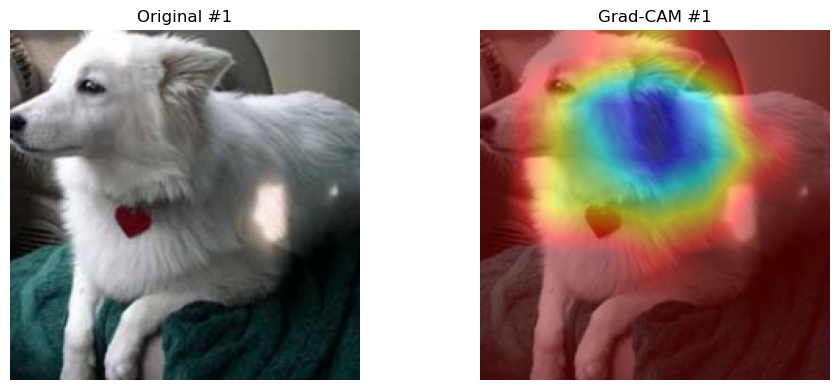

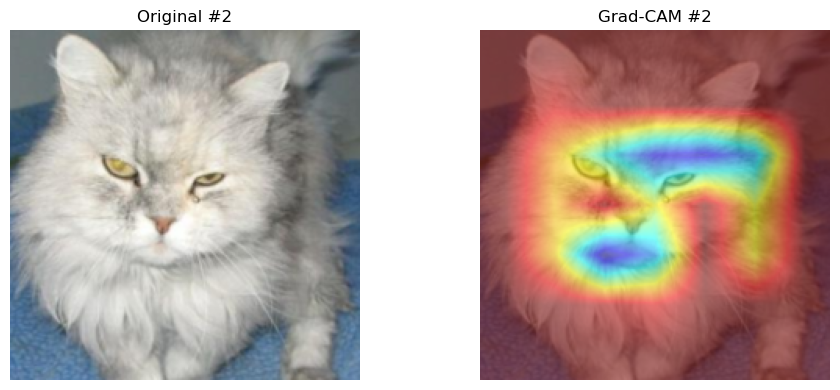

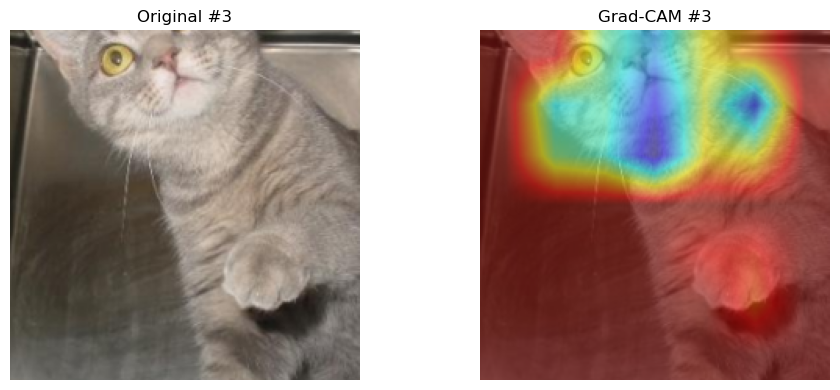

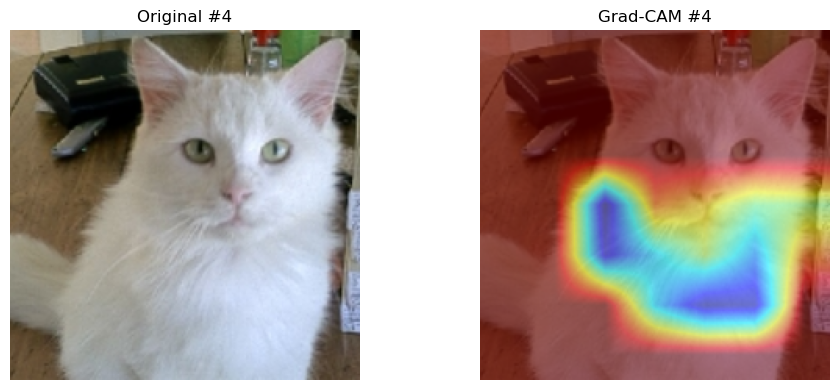

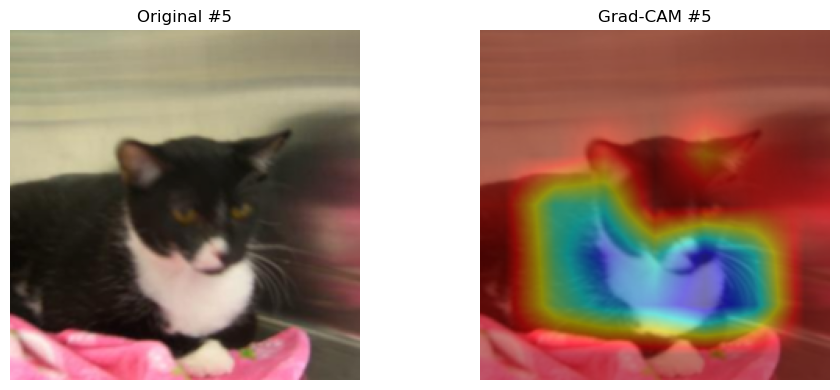

...

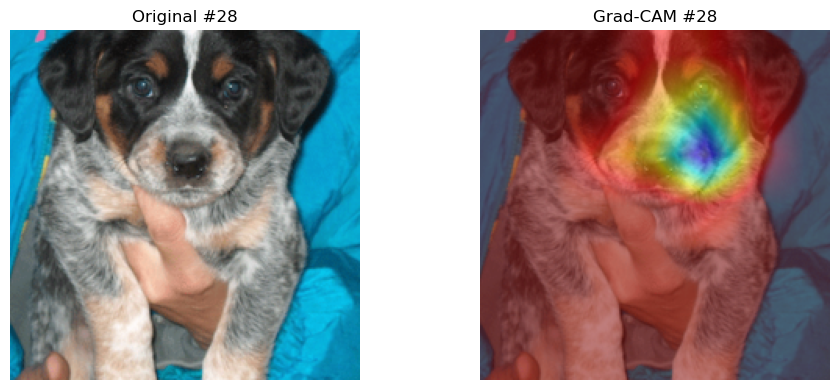

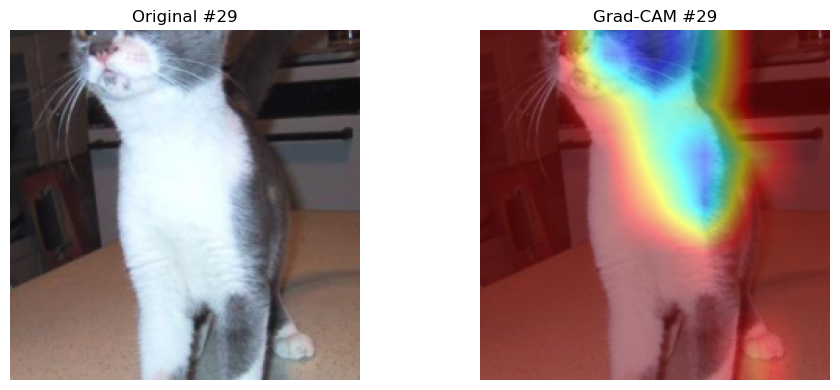

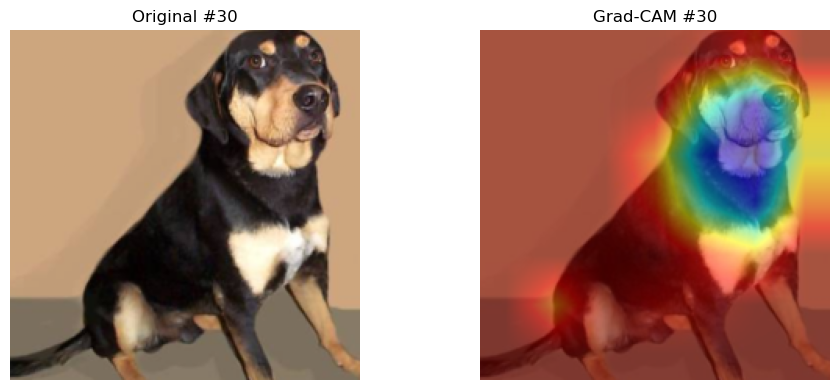

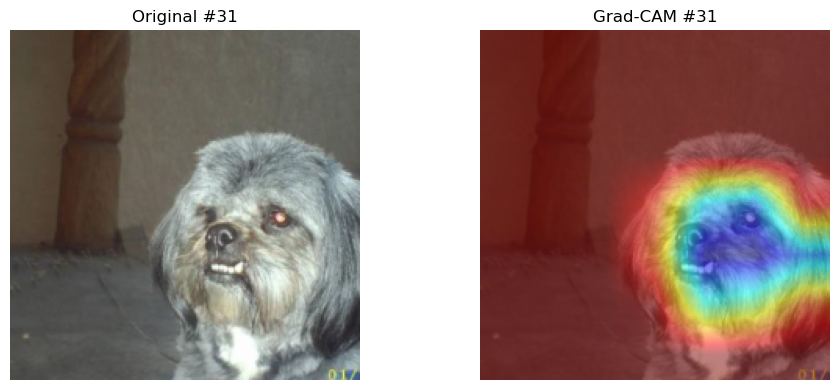

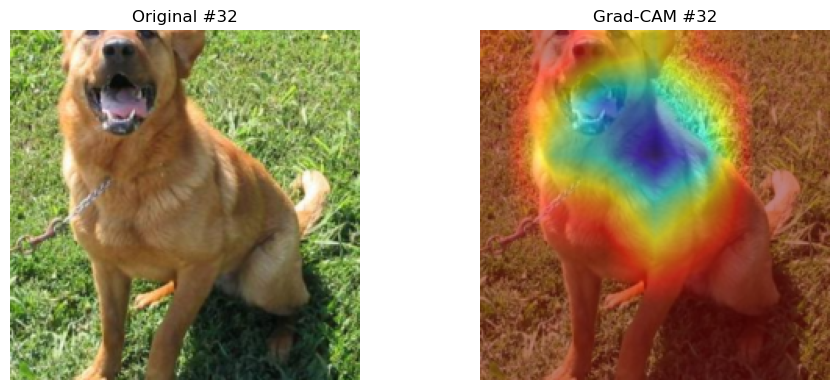

IndexError: index 32 is out of bounds for dimension 0 with size 32

In [41]:
import os
import zipfile
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms, datasets, models
from torch.utils.data import DataLoader, random_split
archive = 'archive.zip'
extract_to = 'data/'
if os.path.exists(archive):
    os.makedirs(extract_to, exist_ok=True)
    with zipfile.ZipFile(archive, 'r') as z:
        z.extractall(extract_to)
    print(f"Unzipped {archive} to {extract_to}")
else:
    print(f"Archive {archive} not found; assuming data/ is already extracted.")
data_dir = os.path.join(extract_to, 'PetImages')
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])
full_dataset = datasets.ImageFolder(data_dir, transform=transform)
train_size = int(0.8 * len(full_dataset))
val_size   = len(full_dataset) - train_size
_, val_ds = random_split(
    full_dataset,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)
batch_size = 32
val_loader = DataLoader(val_ds, batch_size=batch_size,
                        shuffle=False, num_workers=4)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
try:
    weights = models.ResNet50_Weights.IMAGENET1K_V2
    model = models.resnet50(weights=weights)
except AttributeError:
    model = models.resnet50(pretrained=True)
model = model.to(device)
model.eval()
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.grad = None
        self.feat = None
        target_layer.register_forward_hook(
            lambda module, inp, out: setattr(self, 'feat', out)
        )
        target_layer.register_full_backward_hook(
            lambda module, grad_in, grad_out: setattr(self, 'grad', grad_out[0])
        )
    def __call__(self, x, class_idx=None):
        self.model.zero_grad()
        out = self.model(x)
        if class_idx is None:
            class_idx = out.argmax(dim=1).item()
        loss = out[0, class_idx]
        loss.backward(retain_graph=True)
        grad = self.grad[0]
        feat = self.feat[0]
        weights = grad.mean(dim=(1, 2))
        cam = (weights[:, None, None] * feat).sum(dim=0)
        cam = torch.relu(cam)
        cam = cam - cam.min()
        cam = cam / (cam.max() + 1e-8)
        cam_np = cam.detach().cpu().numpy()
        cam_np = cv2.resize(cam_np, (x.size(3), x.size(2)))
        return cam_np
target_layer = model.layer4[-1].conv3
gradcam = GradCAM(model, target_layer)
num_images = 50
imgs, labels = next(iter(val_loader))
for idx in range(num_images):
    img_tensor = imgs[idx:idx+1].to(device)
    true_label = labels[idx].item()
    mask = gradcam(img_tensor, class_idx=None)
    inv_norm = transforms.Normalize(
        mean=[-m/s for m, s in zip([0.485, 0.456, 0.406],
                                   [0.229, 0.224, 0.225])],
        std=[1/s for s in [0.229, 0.224, 0.225]]
    )
    orig = inv_norm(imgs[idx]).permute(1, 2, 0).cpu().numpy()
    orig = np.clip(orig, 0, 1)
    heatmap = cv2.applyColorMap((mask * 255).astype(np.uint8),
                                cv2.COLORMAP_JET) / 255.0
    overlay = heatmap * 0.5 + orig * 0.5
    plt.figure(figsize=(10, 4))
    plt.subplot(1, 2, 1)
    plt.imshow(orig)
    plt.title(f'Original #{idx+1}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(overlay)
    plt.title(f'Grad-CAM #{idx+1}')
    plt.axis('off')

    plt.tight_layout()
    plt.show()
    

<h1 style="font-size:4em;">
GUIDED GRAD CAM
</h1>

Unzipped archive.zip to data/


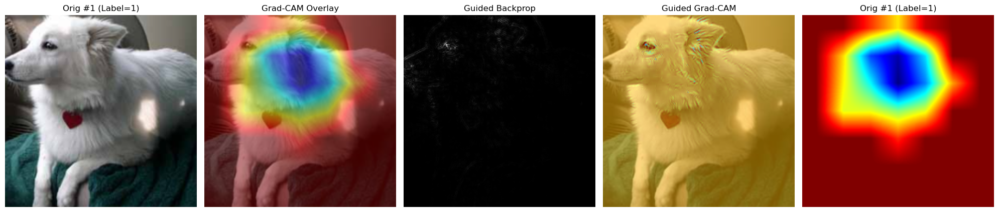

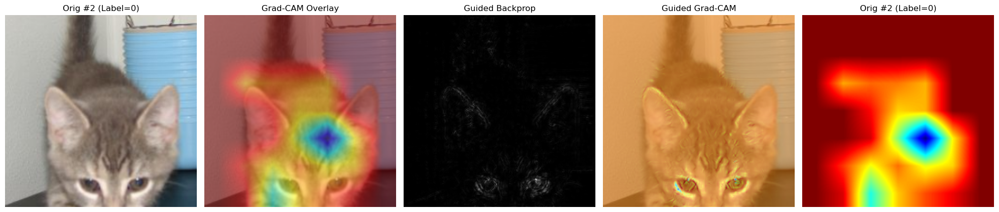

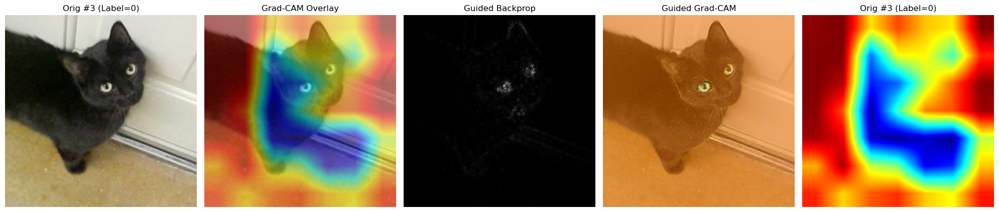

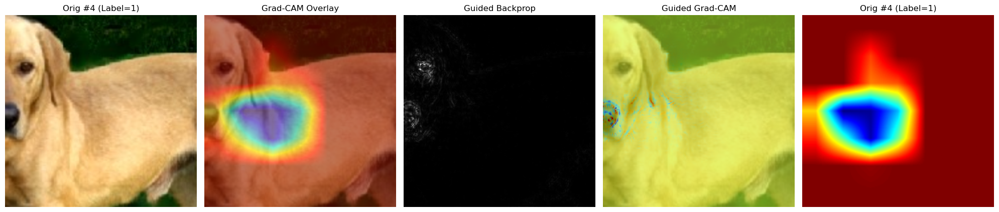

In [5]:
import os
import zipfile
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms, datasets, models
from torch.utils.data import DataLoader, random_split
archive = 'archive.zip'
extract_to = 'data/'
if os.path.exists(archive):
    os.makedirs(extract_to, exist_ok=True)
    with zipfile.ZipFile(archive, 'r') as z:
        z.extractall(extract_to)
    print(f"Unzipped {archive} to {extract_to}")
else:
    print(f"Archive {archive} not found; assuming data/ is already extracted.")
data_dir = os.path.join(extract_to, 'PetImages')
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])
full_dataset = datasets.ImageFolder(data_dir, transform=transform)
train_size = int(0.8 * len(full_dataset))
val_size   = len(full_dataset) - train_size
train_ds, val_ds = random_split(
    full_dataset,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)
batch_size = 32
train_loader = DataLoader(train_ds, batch_size=batch_size,
                          shuffle=True, num_workers=4)
val_loader   = DataLoader(val_ds,   batch_size=batch_size,
                          shuffle=False, num_workers=4)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
try:
    weights = models.ResNet50_Weights.IMAGENET1K_V2
    model = models.resnet50(weights=weights)
except AttributeError:
    model = models.resnet50(pretrained=True)
model = model.to(device)
model.eval()
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.grad = None
        self.feat = None
        target_layer.register_forward_hook(
            lambda module, inp, out: setattr(self, 'feat', out.detach())
        )
        target_layer.register_full_backward_hook(
            lambda module, grad_in, grad_out: setattr(self, 'grad', grad_out[0].detach())
        )
    def __call__(self, x, class_idx=None):
        self.model.zero_grad()
        out = self.model(x)
        if class_idx is None:
            class_idx = out.argmax(dim=1).item()
        loss = out[0, class_idx]
        loss.backward(retain_graph=True)
        grad = self.grad[0]
        feat = self.feat[0]
        weights = grad.mean(dim=(1, 2))
        cam = (weights[:, None, None] * feat).sum(dim=0)
        cam = torch.relu(cam)
        cam = cam - cam.min()
        cam = cam / (cam.max() + 1e-8)
        cam_np = cam.detach().cpu().numpy()
        cam_np = cv2.resize(cam_np, (x.size(3), x.size(2)))
        return cam_np
target_layer = model.layer4[-1].conv3
gradcam = GradCAM(model, target_layer)
class GuidedBackpropReLU(torch.autograd.Function):
    @staticmethod
    def forward(ctx, inp):
        ctx.save_for_backward(inp)
        return torch.relu(inp)
    @staticmethod
    def backward(ctx, grad_out):
        inp, = ctx.saved_tensors
        grad_in = grad_out.clone()
        grad_in[inp < 0] = 0
        grad_in[grad_out < 0] = 0
        return grad_in
class GuidedReLU(nn.Module):
    def forward(self, inp):
        return GuidedBackpropReLU.apply(inp)
def apply_guided_relu(module):
    for name, child in module.named_children():
        if isinstance(child, nn.ReLU):
            setattr(module, name, GuidedReLU())
        else:
            apply_guided_relu(child)
gb_model = models.resnet50(pretrained=False)
try:
    gb_model.load_state_dict(model.state_dict())
except:
    gb_model = model
apply_guided_relu(gb_model)
gb_model = gb_model.to(device)
gb_model.eval()
num_images = 4
inv_norm = transforms.Normalize(
    mean=[-m/s for m, s in zip([0.485, 0.456, 0.406],
                               [0.229, 0.224, 0.225])],
    std =[1/s for s in [0.229, 0.224, 0.225]]
)
data_iter = iter(val_loader)
for i in range(num_images):
    imgs, labels = next(data_iter)
    inp = imgs[0:1].to(device)
    lbl = labels[0].item()
    mask = gradcam(inp, class_idx=None)
    inp_gb = inp.clone().requires_grad_(True)
    gb_model.zero_grad()
    out_gb = gb_model(inp_gb)
    pred_idx = out_gb.argmax(dim=1).item()
    score = out_gb[0, pred_idx]
    score.backward(retain_graph=False)
    guided_grads = inp_gb.grad[0].cpu().numpy().transpose(1, 2, 0)
    guided_cam = np.max(guided_grads * mask[..., None], axis=2)
    guided_cam = (guided_cam - guided_cam.min()) / (guided_cam.max() - guided_cam.min() + 1e-8)
    orig = inv_norm(imgs[0]).permute(1, 2, 0).cpu().numpy().clip(0, 1)
    heat_plain = cv2.applyColorMap((mask * 255).astype(np.uint8), cv2.COLORMAP_JET) / 255.0
    heat_guided = cv2.applyColorMap((guided_cam * 255).astype(np.uint8), cv2.COLORMAP_JET) / 255.0
    overlay_plain = heat_plain * 0.5 + orig * 0.5
    overlay_guided = heat_guided * 0.5 + orig * 0.5
    plt.figure(figsize=(20, 5))

    plt.subplot(1, 5, 5)
    plt.imshow(heat_plain )
    plt.title(f'Orig {i+1} (Label={lbl})')
    plt.axis('off')
    # Original image
    plt.subplot(1, 5, 1)
    plt.imshow(orig)
    plt.title(f'Orig {i+1} (Label={lbl})')
    plt.axis('off')

    # Plain Grad-CAM overlay
    plt.subplot(1, 5, 2)
    plt.imshow(overlay_plain)
    plt.title('Grad-CAM Overlay')
    plt.axis('off')

    # Guided Backprop (sum of absolute grads over channels)
    plt.subplot(1, 5, 3)
    plt.imshow(np.abs(guided_grads).sum(axis=2), cmap='gray')
    plt.title('Guided Backprop')
    plt.axis('off')

    # Guided Grad-CAM overlay
    plt.subplot(1, 5, 4)
    plt.imshow(overlay_guided)
    plt.title('Guided Grad-CAM')
    plt.axis('off')

    plt.tight_layout()
    plt.show()


In [55]:
import torch
print("cuda available:", torch.cuda.is_available())
print("cuda device count:", torch.cuda.device_count())

cuda available: True
cuda device count: 0


In [53]:
del os.environ["CUDA_VISIBLE_DEVICES"]

In [49]:
os.environ["CUDA_VISIBLE_DEVICES"] = "0"

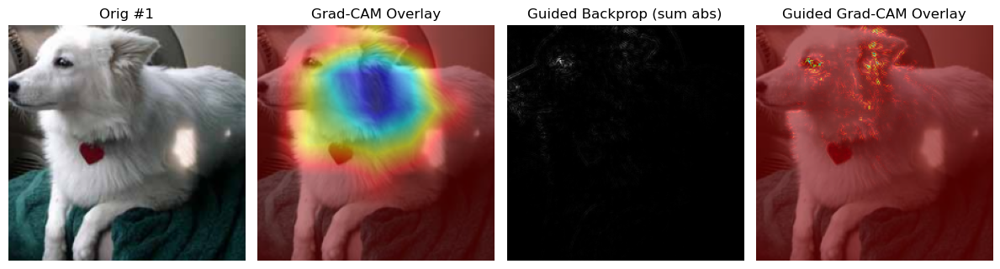

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


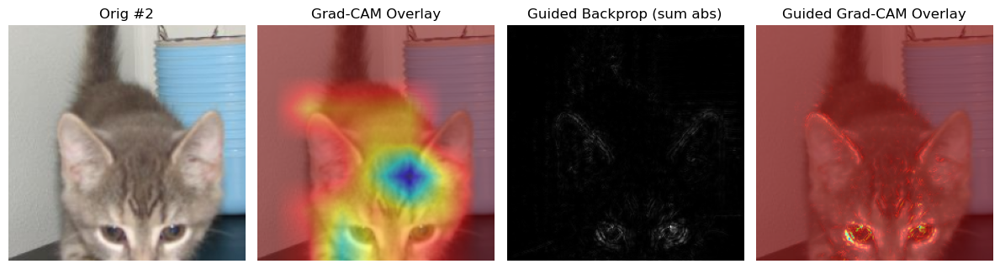

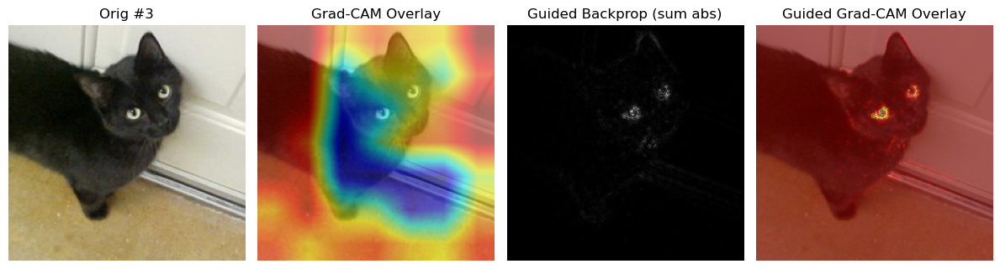

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


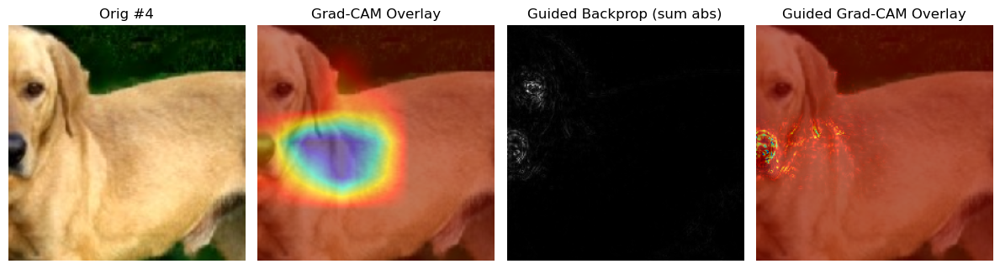

In [65]:
num_images = 4
inv_norm = transforms.Normalize(
    mean=[-m/s for m, s in zip([0.485, 0.456, 0.406],
                               [0.229, 0.224, 0.225])],
    std =[1/s for s in [0.229, 0.224, 0.225]]
)
data_iter = iter(val_loader)
for i in range(num_images):
    imgs, labels = next(data_iter)
    inp = imgs[0:1].to(device)
    mask = gradcam(inp, class_idx=None)
    inp_gb = inp.clone().requires_grad_(True)
    gb_model.zero_grad()
    out_gb = gb_model(inp_gb)
    pred_idx = out_gb.argmax(dim=1).item()
    score = out_gb[0, pred_idx]
    score.backward(retain_graph=False)
    guided_grads = inp_gb.grad[0].cpu().numpy().transpose(1, 2, 0)
    gb_abs = np.abs(guided_grads)
    gb_sum = gb_abs.sum(axis=2)
    gb_norm = (gb_sum - gb_sum.min()) / (gb_sum.max() - gb_sum.min() + 1e-8)
    combined = gb_norm * mask
    combined = (combined - combined.min()) / (combined.max() - combined.min() + 1e-8)
    orig = inv_norm(imgs[0]).permute(1, 2, 0).cpu().numpy().clip(0, 1)
    heat_plain = cv2.applyColorMap((mask * 255).astype(np.uint8),
                                  cv2.COLORMAP_JET) / 255.0
    overlay_plain = heat_plain * 0.5 + orig * 0.5
    gb_display = gb_sum.copy()
    heat_guided = cv2.applyColorMap((combined * 255).astype(np.uint8),
                                    cv2.COLORMAP_JET) / 255.0
    overlay_guided = heat_guided * 0.6 + orig * 0.4
    plt.figure(figsize=(12, 4))

   
    plt.subplot(1, 4, 1)
    plt.imshow(orig)
    plt.title(f'Orig {i+1}')
    plt.axis('off')

    
    plt.subplot(1, 4, 2)
    plt.imshow(overlay_plain)
    plt.title('Grad-CAM Overlay')
    plt.axis('off')

    
    plt.subplot(1, 4, 3)
    plt.imshow(gb_display, cmap='gray')
    plt.title('Guided Backprop (sum abs)')
    plt.axis('off')

    
    plt.subplot(1, 4, 4)
    plt.imshow(overlay_guided)
    plt.title('Guided Grad-CAM Overlay')
    plt.axis('off')

    plt.tight_layout()
    plt.show()

<h1 style="font-size:4em;">
FEATURE VISUALIZATION
</h1>

Unzipped archive.zip to data/
Feature maps shape: torch.Size([32, 2048, 7, 7])


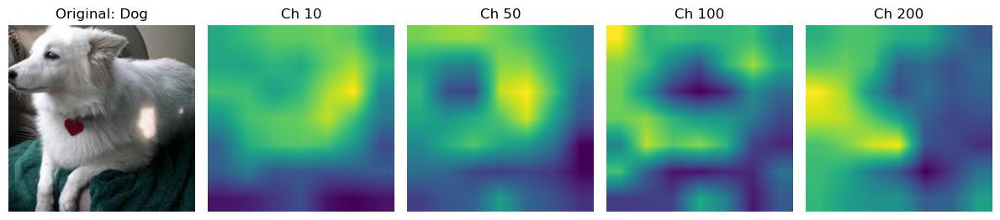

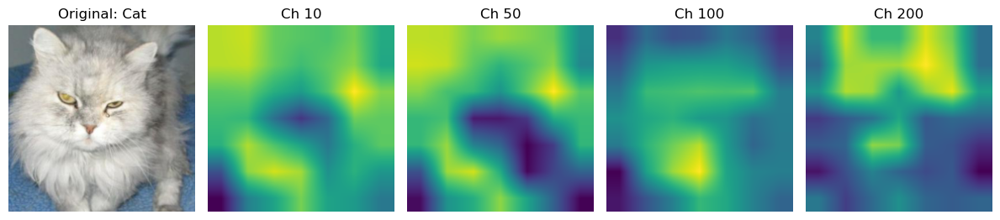

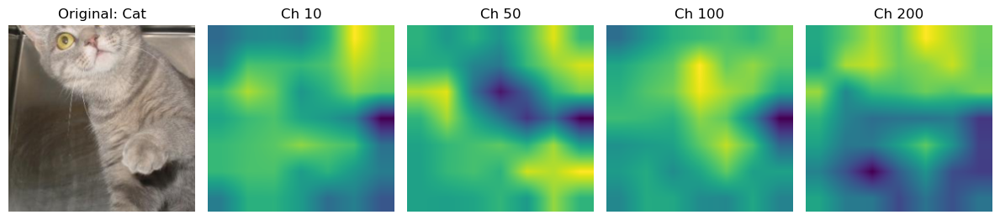

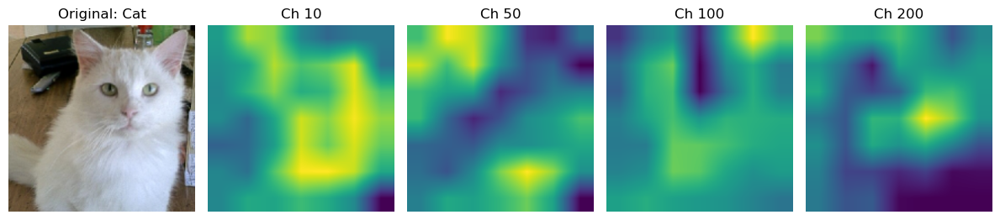

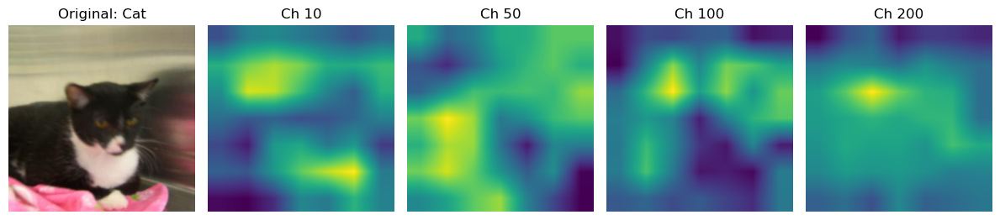

...

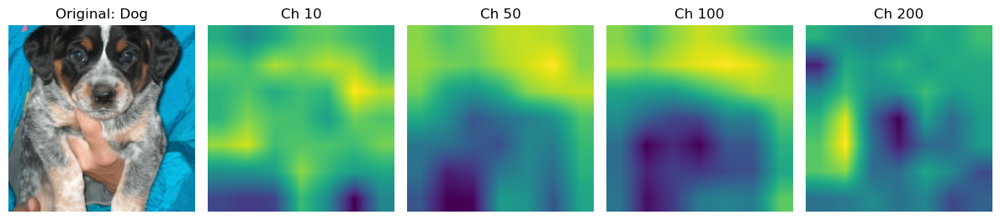

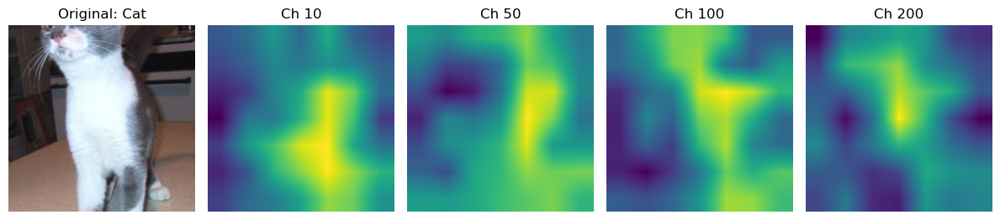

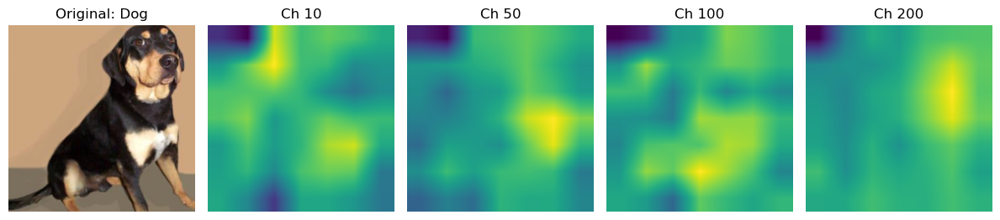

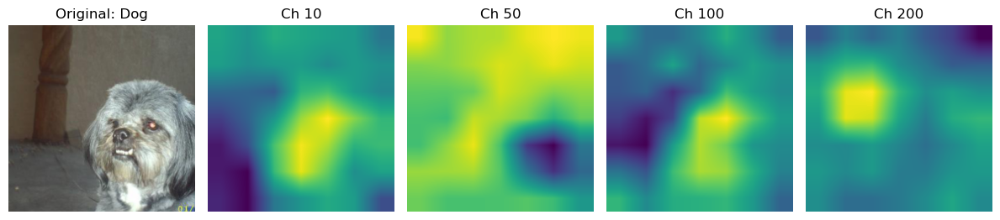

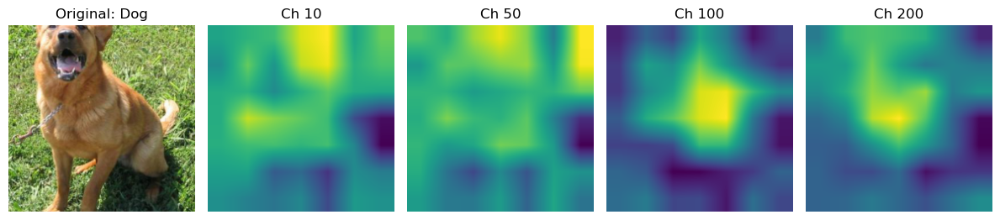

IndexError: index 32 is out of bounds for dimension 0 with size 32

In [7]:
import os
import zipfile
import cv2
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn as nn
from torchvision import transforms, datasets, models
from torch.utils.data import DataLoader, random_split
archive = 'archive.zip'
extract_to = 'data/'
if os.path.exists(archive):
    os.makedirs(extract_to, exist_ok=True)
    with zipfile.ZipFile(archive, 'r') as z:
        z.extractall(extract_to)
    print(f"Unzipped {archive} to {extract_to}")
else:
    print(f"Archive {archive} not found; assuming data/ is already extracted.")
data_dir = os.path.join(extract_to, 'PetImages')
transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize([0.485, 0.456, 0.406],
                         [0.229, 0.224, 0.225])
])
full_dataset = datasets.ImageFolder(data_dir, transform=transform)
train_size = int(0.8 * len(full_dataset))
val_size   = len(full_dataset) - train_size
_, val_ds = random_split(
    full_dataset,
    [train_size, val_size],
    generator=torch.Generator().manual_seed(42)
)
batch_size = 32
val_loader = DataLoader(val_ds, batch_size=batch_size,
                        shuffle=False, num_workers=4)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
try:
    weights = models.ResNet50_Weights.IMAGENET1K_V2
    model = models.resnet50(weights=weights)
except AttributeError:
    model = models.resnet50(pretrained=True)
model = model.to(device)
model.eval()
activation = {}
def get_activation(name):
    def hook(model, input, output):
        activation[name] = output.detach()
    return hook
target_layer = model.layer4[-1].conv3
target_layer.register_forward_hook(get_activation('layer4_conv3'))
inv_normalize = transforms.Normalize(
    mean=[-m/s for m, s in zip([0.485, 0.456, 0.406],
                               [0.229, 0.224, 0.225])],
    std=[1/s for s in [0.229, 0.224, 0.225]]
)
def imshow_tensor(img_tensor):
    """
    Converts a normalized tensor [3,224,224] → a H×W×3 array in [0,1].
    """
    img = inv_normalize(img_tensor).permute(1,2,0).cpu().numpy()
    return np.clip(img, 0, 1)
classes = full_dataset.classes
model.eval()
imgs, labels = next(iter(val_loader))
imgs = imgs.to(device)
labels = labels.to(device)
with torch.no_grad():
    _ = model(imgs)
feat_maps = activation['layer4_conv3']
batch_size, n_channels, Hf, Wf = feat_maps.shape
print(f"Feature maps shape: {feat_maps.shape}")
selected_channels = [10, 50, 100, 200]
for idx in range(100):
    img_tensor = imgs[idx]
    label = labels[idx].item()
    fmap = feat_maps[idx]
    orig_img = imshow_tensor(img_tensor)
    plt.figure(figsize=(12, 3))
    plt.subplot(1, len(selected_channels) + 1, 1)
    plt.imshow(orig_img)
    plt.title(f"Original: {classes[label]}")
    plt.axis('off')
    for i, ch in enumerate(selected_channels):
        channel_map = fmap[ch].cpu().numpy()
        channel_map_resized = cv2.resize(channel_map, (224, 224), interpolation=cv2.INTER_LINEAR)
        channel_map_resized = (channel_map_resized - channel_map_resized.min()) / (
            channel_map_resized.max() - channel_map_resized.min() + 1e-8
        )
        plt.subplot(1, len(selected_channels) + 1, i+2)
        plt.imshow(channel_map_resized, cmap='viridis')
        plt.title(f"Ch {ch}")
        plt.axis('off')
    plt.tight_layout()
    plt.show()

<h1 style="font-size:4em;">
PGD ATTACK AND GRAD CAM
</h1>

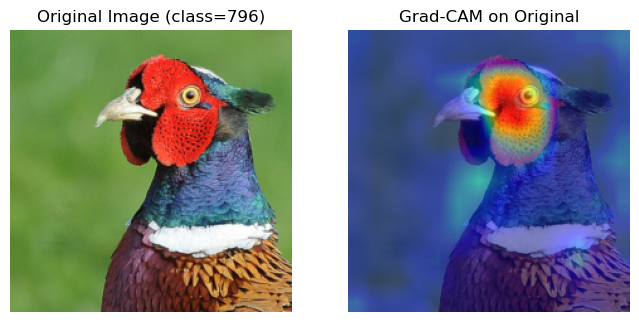

ε = 0.01 → Predicted adv class = 86, prob = 0.98601127
ε = 0.08 → Predicted adv class = 85, prob = 1.00000000
ε = 0.15 → Predicted adv class = 601, prob = 1.00000000


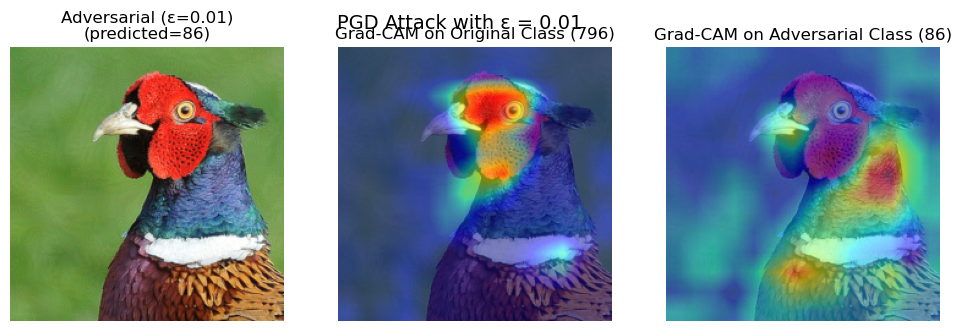

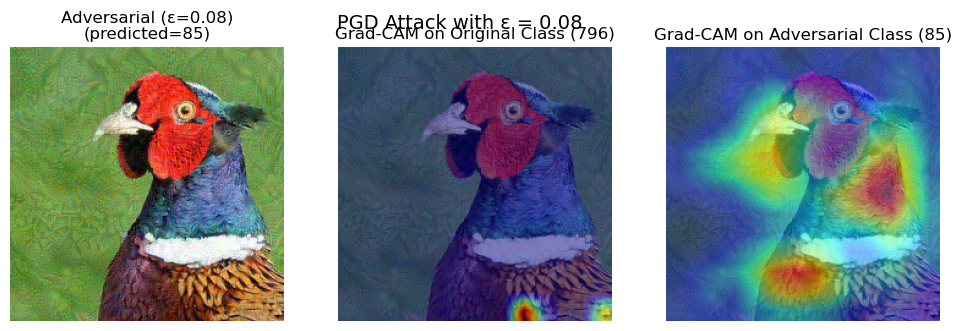

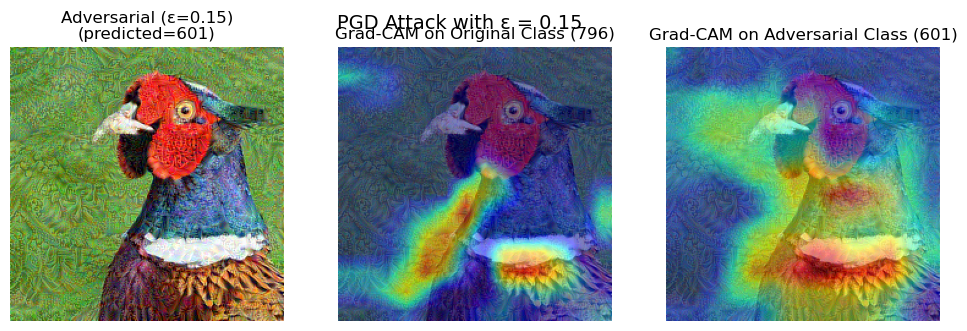

In [15]:
import os
import torch
import torch.nn.functional as F
from torchvision import models, transforms
from PIL import Image
import numpy as np
import matplotlib.pyplot as plt
import torchattacks
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
img_path = "n01514668_cock.JPEG"
if not os.path.exists(img_path):
    raise FileNotFoundError(f"Could not find {img_path} in the working directory.")
orig_pil = Image.open(img_path).convert("RGB")
preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
])
def tensor_to_image_uint8(tensor_01):
    """
    Input: tensor in [0,1] with shape [3,224,224]
    Output: numpy array in [0,1] with shape [224,224,3]
    """
    img = tensor_01.clone().cpu()
    img = torch.clamp(img, 0, 1)
    return img.permute(1,2,0).numpy()
input_tensor = preprocess(orig_pil).unsqueeze(0).to(device)
model = models.vgg16(pretrained=True).to(device)
model.eval()
class GradCAM:
    def __init__(self, model, target_layer):
        self.model = model
        self.activations = None
        self.gradients   = None
        self.target_layer = target_layer
        self._register_hooks()
    def _register_hooks(self):
        def forward_hook(module, _input, output):
            self.activations = output.detach()
        def backward_hook(module, grad_in, grad_out):
            self.gradients = grad_out[0].detach()
        self.target_layer.register_forward_hook(forward_hook)
        self.target_layer.register_backward_hook(backward_hook)
    def generate_cam(self, input_tensor, class_idx):
        """
        Input:
         - input_tensor: [1,3,224,224] (in [0,1], without Normalize)
         - class_idx: target class index
        Output:
         - cam: numpy array [h, w] in [0,1]
        """
        output = self.model(input_tensor)
        self.model.zero_grad()
        one_hot = torch.zeros_like(output)
        one_hot[0, class_idx] = 1
        output.backward(gradient=one_hot, retain_graph=True)
        pooled_grads = torch.mean(self.gradients, dim=(2,3), keepdim=True)
        weighted_activations = pooled_grads * self.activations
        cam = torch.sum(weighted_activations, dim=1, keepdim=True)
        cam = F.relu(cam)
        cam = cam.squeeze().cpu().numpy()
        cam -= cam.min()
        cam /= (cam.max() + 1e-8)
        return cam
with torch.no_grad():
    out_orig = model(input_tensor)
    pred_idx = out_orig.argmax(dim=1).item()
target_layer = model.features[29]
cam_generator = GradCAM(model, target_layer)
from PIL import Image
def resize_cam(cam_mask, size=(224,224)):
    """
    cam_mask: numpy [h,w] in [0,1]
    Output: numpy [size, size] in [0,1]
    """
    cam_uint8 = np.uint8(255 * cam_mask)
    cam_pil   = Image.fromarray(cam_uint8).resize(size, Image.BILINEAR)
    cam_resized = np.array(cam_pil) / 255.0
    return cam_resized
cam_orig = cam_generator.generate_cam(input_tensor, pred_idx)
cam_orig_resized = resize_cam(cam_orig, size=(224,224))
orig_img_np = tensor_to_image_uint8(input_tensor.squeeze(0))
plt.figure(figsize=(8,4))
plt.subplot(1,2,1)
plt.imshow(orig_img_np)
plt.title(f"Original Image (class={pred_idx})")
plt.axis("off")
plt.subplot(1,2,2)
plt.imshow(orig_img_np)
plt.imshow(cam_orig_resized, cmap="jet", alpha=0.5)
plt.title("Grad-CAM on Original")
plt.axis("off")
plt.show()
epsilons = [0.01, 0.08, 0.15]
pgd_attacks = {}
for eps in epsilons:
    alpha = eps / 10
    pgd_attacks[eps] = torchattacks.PGD(
        model,
        eps=eps,
        alpha=alpha,
        steps=40,
        random_start=True
    )
cam_adv_dict = {}
adv_imgs = {}
for eps, attack in pgd_attacks.items():
    adv_example = attack(input_tensor, torch.tensor([pred_idx]).to(device))
    with torch.no_grad():
        out_adv = model(adv_example)
        pred_adv = out_adv.argmax(dim=1).item()
        probs_adv = F.softmax(out_adv, dim=1)
        top1_adv = probs_adv[0, pred_adv].item()
        print(f"ε = {eps:.2f} → Predicted adv class = {pred_adv}, prob = {top1_adv:.8f}")
    cam_adv_origcls = cam_generator.generate_cam(adv_example, pred_idx)
    cam_adv_origcls = resize_cam(cam_adv_origcls, size=(224,224))
    cam_adv_newcls  = cam_generator.generate_cam(adv_example, pred_adv)
    cam_adv_newcls  = resize_cam(cam_adv_newcls, size=(224,224))
    cam_adv_dict[eps] = {
        "orig_class": cam_adv_origcls,
        "adv_class": cam_adv_newcls,
        "pred_adv": pred_adv
    }
    adv_imgs[eps] = adv_example.detach().cpu().squeeze(0)
for eps in epsilons:
    adv_tensor = adv_imgs[eps]
    adv_img_np  = tensor_to_image_uint8(adv_tensor)
    cam_o = cam_adv_dict[eps]["orig_class"]
    cam_n = cam_adv_dict[eps]["adv_class"]
    pred_adv = cam_adv_dict[eps]["pred_adv"]
    plt.figure(figsize=(12,4))
    plt.subplot(1,3,1)
    plt.imshow(adv_img_np)
    plt.title(f"Adversarial (ε={eps:.2f})\n(predicted={pred_adv})")
    plt.axis("off")
    plt.subplot(1,3,2)
    plt.imshow(adv_img_np)
    plt.imshow(cam_o, cmap="jet", alpha=0.5)
    plt.title(f"Grad-CAM on Original Class ({pred_idx})")
    plt.axis("off")
    plt.subplot(1,3,3)
    plt.imshow(adv_img_np)
    plt.imshow(cam_n, cmap="jet", alpha=0.5)
    plt.title(f"Grad-CAM on Adversarial Class ({pred_adv})")
    plt.axis("off")
    plt.suptitle(f"PGD Attack with ε = {eps:.2f}", y=0.92, fontsize=14)
    plt.show()

<h1 style="font-size:4em;">
CLASS FEATURE VISUALIZATION 

</h1>

Iter   0 → 293 logit = 0.816
Iter  10 → 293 logit = 198.467
Iter  20 → 293 logit = 527.830
Iter  30 → 293 logit = 803.655
Iter  40 → 293 logit = 999.372
Iter  50 → 293 logit = 1119.974
Iter  60 → 293 logit = 1250.925
Iter  70 → 293 logit = 1318.327
Iter  80 → 293 logit = 1391.699
Iter  90 → 293 logit = 1464.627
Iter 100 → 293 logit = 1483.967
Iter 110 → 293 logit = 1565.529
Iter 120 → 293 logit = 1618.967
Iter 130 → 293 logit = 1586.627
Iter 140 → 293 logit = 1673.961
Iter 150 → 293 logit = 1702.958
Iter 160 → 293 logit = 1695.550
Iter 170 → 293 logit = 1749.835
Iter 180 → 293 logit = 1773.743
Iter 190 → 293 logit = 1808.346
Iter 200 → 293 logit = 1819.649
Iter 210 → 293 logit = 1870.063
Iter 220 → 293 logit = 1868.672
Iter 230 → 293 logit = 1868.488
Iter 240 → 293 logit = 1903.757
Iter 250 → 293 logit = 1918.022
Iter 260 → 293 logit = 1940.316
Iter 270 → 293 logit = 1951.946
Iter 280 → 293 logit = 1953.530
Iter 290 → 293 logit = 1964.426
Iter 300 → 293 logit = 1974.016
Iter 310 → 293 

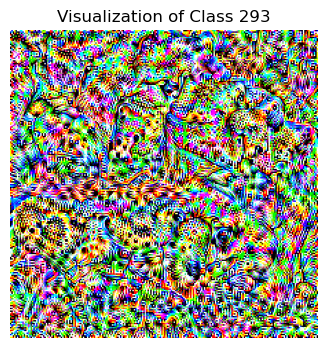

In [17]:
import torch
import torch.nn.functional as F
from torchvision import models
import matplotlib.pyplot as plt
import numpy as np
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = models.vgg16(pretrained=True).to(device).eval()
target_class = 293
input_img = torch.randn(1, 3, 224, 224, device=device, requires_grad=True)
mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(1,3,1,1)
std  = torch.tensor([0.229, 0.224, 0.225], device=device).view(1,3,1,1)
optimizer = torch.optim.AdamW([input_img], lr=0.5, weight_decay=1e-6)
for iteration in range(500):
    optimizer.zero_grad()
    normalized = (input_img - mean) / std
    outputs = model(normalized)
    score = outputs[0, target_class]
    loss = -score
    loss.backward()
    optimizer.step()
    with torch.no_grad():
        input_img.clamp_(0, 1)
    if iteration % 10 == 0:
        print(f"Iter {iteration:3d} → {target_class} logit = {score.item():.3f}")
result_img = input_img.detach().cpu().squeeze().permute(1,2,0).numpy()
plt.figure(figsize=(4,4))
plt.imshow(result_img)
plt.title(f"Visualization of Class {target_class}")
plt.axis('off')
plt.show()

Iter    0 | Score: -0.099 | TV: 25964.2
Iter  200 | Score: 381.000 | TV: 23975.3
Iter  400 | Score: 615.992 | TV: 29074.2
Iter  600 | Score: 685.313 | TV: 30221.0
Iter  800 | Score: 723.348 | TV: 30071.9
Iter 1000 | Score: 742.448 | TV: 29636.9
Iter 1200 | Score: 690.342 | TV: 29081.7
Iter 1400 | Score: 680.247 | TV: 28479.2
Iter 1600 | Score: 785.286 | TV: 27938.2
Iter 1800 | Score: 741.637 | TV: 27641.1
Iter 2000 | Score: 779.703 | TV: 27462.4
Iter 2200 | Score: 769.827 | TV: 27324.5
Iter 2400 | Score: 858.495 | TV: 27192.4
Iter 2600 | Score: 836.744 | TV: 27022.9
Iter 2800 | Score: 827.573 | TV: 26981.5
Iter 3000 | Score: 868.980 | TV: 27119.7
Iter 3200 | Score: 817.435 | TV: 26902.0
Iter 3400 | Score: 739.909 | TV: 26894.6
Iter 3600 | Score: 889.417 | TV: 26927.5
Iter 3800 | Score: 873.591 | TV: 26847.0
Iter 4000 | Score: 911.878 | TV: 26930.1
Iter 4200 | Score: 898.370 | TV: 26857.8
Iter 4400 | Score: 1022.846 | TV: 27287.5
Iter 4600 | Score: 1004.174 | TV: 28446.5
Iter 4800 | Sco

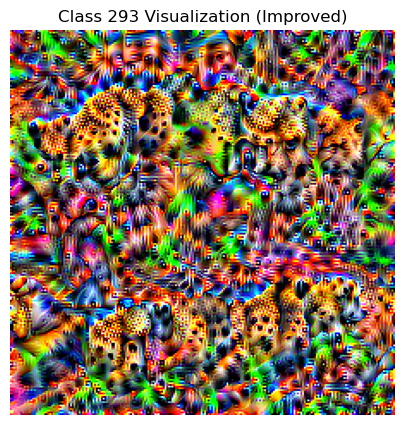

In [19]:
import torch
import torch.nn.functional as F
from torchvision import models
import matplotlib.pyplot as plt
import numpy as np
def total_variation_loss(img):
    """
    Isotropic TV over the inner (H-1)x(W-1) grid.
    """
    dh = img[:, :, 1:, 1:] - img[:, :, :-1, 1:]
    dw = img[:, :, 1:, 1:] - img[:, :, 1:, :-1]
    return torch.sqrt(dh**2 + dw**2 + 1e-6).sum()
def jitter(img, max_shift):
    """
    Randomly shift the image by up to ±max_shift pixels.
    Returns shifted image and the shifts (dx, dy) to invert later.
    """
    dx = np.random.randint(-max_shift, max_shift + 1)
    dy = np.random.randint(-max_shift, max_shift + 1)
    return torch.roll(img, shifts=(dx, dy), dims=(2, 3)), dx, dy
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = models.vgg16(pretrained=True).to(device).eval()
target_class = 293
input_img = torch.randn(1, 3, 224, 224, device=device) * 0.1 + 0.5
input_img = input_img.clamp(0, 1).requires_grad_(True)
mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(1,3,1,1)
std  = torch.tensor([0.229, 0.224, 0.225], device=device).view(1,3,1,1)
optimizer = torch.optim.Adam([input_img], lr=0.05, weight_decay=1e-6)
tv_weight     = 1e-2
max_jitter    = 32
num_iterations = 5000
for i in range(num_iterations):
    optimizer.zero_grad()
    curr_jitter = int(max_jitter * (1 - i / num_iterations))
    img_jit, dx, dy = jitter(input_img, curr_jitter)
    normalized = (img_jit - mean) / std
    outputs = model(normalized)
    score = outputs[0, target_class]
    tv_loss_val = total_variation_loss(img_jit)
    loss = -score + tv_weight * tv_loss_val
    loss.backward()
    optimizer.step()
    with torch.no_grad():
        input_img.data = torch.roll(input_img.data, shifts=(-dx, -dy), dims=(2, 3))
        input_img.data.clamp_(0, 1)
    if i % 200 == 0 or i == num_iterations - 1:
        print(f"Iter {i:4d} | Score: {score.item():.3f} | TV: {tv_loss_val.item():.1f}")
result = input_img.detach().cpu().squeeze().permute(1,2,0).numpy()
plt.figure(figsize=(5,5))
plt.imshow(result)
plt.title(f"Class {target_class} Visualization (Improved)")
plt.axis('off')
plt.show()

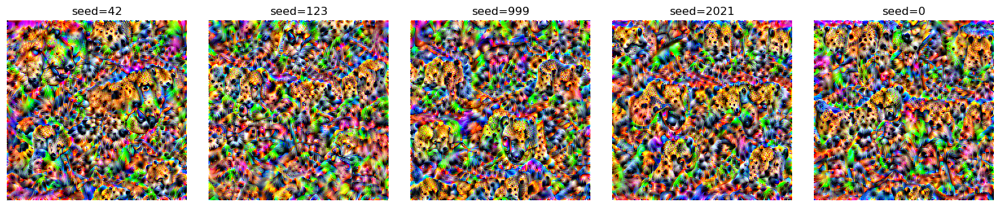

In [21]:
import torch
import torch.nn.functional as F
from torchvision import models
import matplotlib.pyplot as plt
import numpy as np
import os
def total_variation_loss(img):
    dh = img[:, :, 1:, 1:] - img[:, :, :-1, 1:]
    dw = img[:, :, 1:, 1:] - img[:, :, 1:, :-1]
    return torch.sqrt(dh**2 + dw**2 + 1e-6).sum()
def jitter(img, max_shift):
    dx = np.random.randint(-max_shift, max_shift + 1)
    dy = np.random.randint(-max_shift, max_shift + 1)
    return torch.roll(img, shifts=(dx, dy), dims=(2, 3)), dx, dy
def visualize_seed(seed, out_path):
    np.random.seed(seed)
    torch.manual_seed(seed)
    device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    model  = models.vgg16(pretrained=True).to(device).eval()
    target_class   = 293
    tv_weight      = 1e-2
    max_jitter     = 32
    num_iterations = 10000
    lr             = 0.05
    mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(1,3,1,1)
    std  = torch.tensor([0.229, 0.224, 0.225], device=device).view(1,3,1,1)
    img = torch.randn(1,3,224,224,device=device)*0.1 + 0.5
    img = img.clamp(0,1).requires_grad_(True)
    optimizer = torch.optim.Adam([img], lr=lr, weight_decay=1e-6)
    for i in range(num_iterations):
        optimizer.zero_grad()
        curr_jit = int(max_jitter * (1 - i/num_iterations))
        img_jit, dx, dy = jitter(img, curr_jit)
        inp = (img_jit - mean) / std
        out = model(inp)
        score = out[0, target_class]
        tv = total_variation_loss(img_jit)
        loss = -score + tv_weight * tv
        loss.backward()
        optimizer.step()
        with torch.no_grad():
            img.data = torch.roll(img.data, shifts=(-dx, -dy), dims=(2,3))
            img.data.clamp_(0,1)
    result = img.detach().cpu().squeeze().permute(1,2,0).numpy()
    plt.imsave(out_path, result)
    return result
seeds = [42, 123, 999, 2021, 0]
os.makedirs('outputs', exist_ok=True)
images = []
for s in seeds:
    path = f'outputs/vis_seed_{s}.png'
    img = visualize_seed(s, path)
    images.append((s, img))
fig, axes = plt.subplots(1, 5, figsize=(15,3))
for ax, (s, img) in zip(axes, images):
    ax.imshow(img)
    ax.axis('off')
    ax.set_title(f"seed={s}")
plt.tight_layout()
plt.show()